# Constants and useful functions

In [34]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.pylab as pylab
import math
import numpy as np
import xlsxwriter
from openpyxl import load_workbook

from ipynb.fs.full.UtilCollections import PARAMS, POSITIONS, SEASONS, TEAMS
from ipynb.fs.full.UtilFunctions import format_season, mean

In [35]:
pylab.rcParams.update(PARAMS)

In [36]:
def get_stat_by_position_each_season(stat, stats_by_pos):
    stat_by_pos_each_season = {}

    for position in POSITIONS:
        stat_by_pos_each_season[position] = []

    for season in stats_by_pos:    
        for position in season.index:
            if position in POSITIONS:
                stat_by_pos_each_season[position].append(season.loc[position][stat]) 
            
    return stat_by_pos_each_season


In [37]:
def group_seasons(dfs, seasons, stat):
    result = []
    for i in range(0, len(seasons), 3):
        df = dfs[i]
        max_g = df.max()['G']
        df = df[df['G'] >= max_g / 2]
        if i+1 < len(seasons):
            df2 = dfs[i+1]
            max_g = df2.max()['G']
            df2 = df2[df2['G'] >= max_g / 2]
            df = df.append(df2)
        if i+2 < len(seasons):
            df3 = dfs[i+2]
            max_g = df3.max()['G']
            df3 = df3[df3['G'] >= max_g / 2]
            df = df.append(df3)
        
        df = df[df["Tm"] != "TOT"]
        df = df[df["MP"] >= 5]
        if stat == "Mean":
            df = pd.DataFrame(df.groupby(by=['Pos']).mean())
        elif stat == "Sd":
            df = pd.DataFrame(df.groupby(by=['Pos']).std())
        elif stat == "Median":
            df = pd.DataFrame(df.groupby(by=['Pos']).median())
        result.append(df)
    return result


In [38]:
def plot_position_graph(positions_dict, graph_title, measure, seasons, playoffs=False):
    
    plt.figure(figsize=(12, 8), dpi=80)
    plt.grid()
    for position in POSITIONS:
        plt.plot(seasons, positions_dict[position], label=position, lw=3, marker='o', ms=10)

    plt.xticks(seasons[::3])
    plt.ylabel(f"{measure} {graph_title}", fontsize=18)
    plt.legend(loc='center left', bbox_to_anchor=(0.95, 0.5),
          fancybox=True, shadow=True, ncol=1, prop={'size': 15})
    
    if '/' in graph_title:
        graph_title = graph_title.replace('/', '_')

    if playoffs:
        plt.xlabel("Playoff Season", fontsize=18)
        plt.savefig(f"Results/PositionsEvolution_Playoffs/{measure}_{graph_title}.png", bbox_inches='tight')
    else:
        plt.xlabel("Season", fontsize=18)
        plt.savefig(f"Results/PositionsEvolution/{measure}_{graph_title}.png", bbox_inches='tight')
    plt.show()

In [39]:
def plot_position_graph_grouped_seasons(positions_dict, graph_title, measure, seasons, playoffs=False):
    
    plt.figure(figsize=(12, 8), dpi=80)
    plt.grid()
    for position in POSITIONS:
        plt.plot(seasons[::3], positions_dict[position], label=position, lw=3, marker='o', ms=10)

    plt.xticks(seasons[::3], ["2000-2002", "2003-2005", "2006-2008", "2009-2011", "2012-2014", "2015-2017", "2018-2020", "2021-2022"])
    plt.ylabel(f"{measure} {graph_title}", fontsize=18)
    plt.legend(loc='center left', bbox_to_anchor=(0.95, 0.5),
          fancybox=True, shadow=True, ncol=1, prop={'size': 15})
    
    if '/' in graph_title:
        graph_title = graph_title.replace('/', '_')

    if playoffs:
        plt.xlabel("Playoff Season", fontsize=18)
        plt.savefig(f"Results/PositionsEvolution_Playoffs/GroupedSeasons/{measure}_{graph_title}.png", bbox_inches='tight')
    else:
        plt.xlabel("Season", fontsize=18)
        plt.savefig(f"Results/PositionsEvolution/GroupedSeasons/{measure}_{graph_title}.png", bbox_inches='tight')
    plt.show()

In [40]:
def get_csvs_by_season(season):
    first_year, second_year = format_season(season)
    
    player_df = pd.read_csv("DataCollection/Player_Stats/player_stats_{0}-{1}.csv".format(first_year, second_year))
    playoff_player_df = pd.read_csv("DataCollection/Player_Stats_Playoffs/player_stats_playoffs_{0}-{1}.csv".format(first_year, second_year))
    
    return player_df, playoff_player_df

In [41]:
player_dfs, playoff_player_dfs = [], []

for season in SEASONS:
    player_df, playoff_player_df = get_csvs_by_season(season)
    player_dfs.append(player_df)
    playoff_player_dfs.append(playoff_player_df)


# Analyzing highest scorers by position

In [42]:
highest_scorer_by_pos_and_season = {}
for team in TEAMS:
    highest_scorer_by_pos_and_season[team] = {}
    
for i in range(len(SEASONS)):
    df = pd.DataFrame(player_dfs[i])
    df.sort_values(by=['Tm', 'PTS'], ascending=[True, False], inplace=True)
    for team in TEAMS:
        players_from_team = df[df['Tm'] == team]
        if not players_from_team.empty:
            highest_scorer_from_team = players_from_team.iloc[0][['Pos', 'PTS']]
            highest_scorer_by_pos_and_season[team][SEASONS[i]] = list(highest_scorer_from_team)

In [43]:
position_with_more_scoring = {}

for position in POSITIONS:
    position_with_more_scoring[position] = np.zeros(len(SEASONS), dtype=int)
    
for i in range(len(SEASONS)):
    season = SEASONS[i]
    for team in TEAMS:
        if season in highest_scorer_by_pos_and_season[team]:
            position = highest_scorer_by_pos_and_season[team][season][0]
            if position in POSITIONS:        
                position_with_more_scoring[position][i] += 1

### Highest scores with and withou label - each season

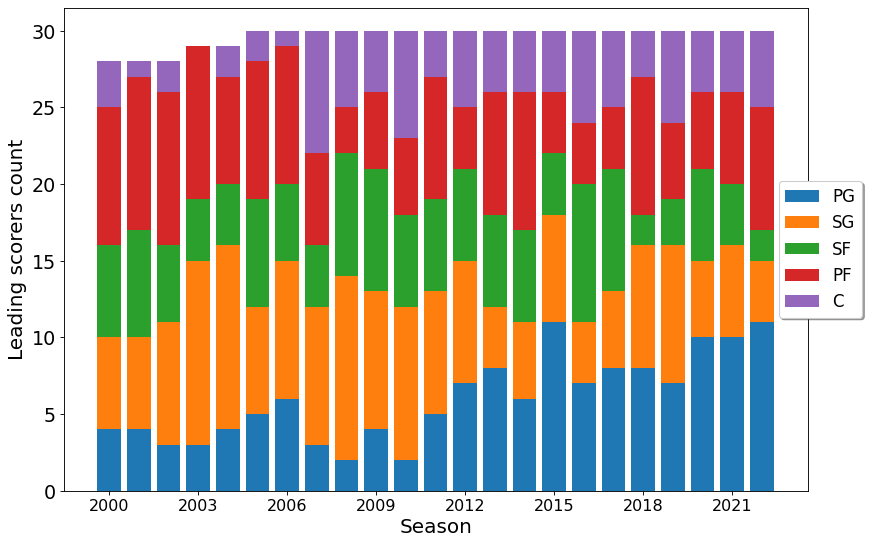

In [44]:
plt.figure(figsize=(12, 8), dpi=80)

counter = np.zeros(len(SEASONS))

for position in POSITIONS:
    plt.bar(SEASONS, position_with_more_scoring[position], bottom=counter, label=position)
    counter += np.array(position_with_more_scoring[position])

plt.xlabel("Season", fontsize=18)
plt.ylabel("Leading scorers count", fontsize=18)
plt.xticks(SEASONS[::3])
plt.legend(loc='center left', bbox_to_anchor=(0.95, 0.5),
          fancybox=True, shadow=True, ncol=1, prop={'size': 15})
plt.savefig("Results/PositionsEvolution/Positions_with_most_scoring.png", bbox_inches='tight')
plt.show()

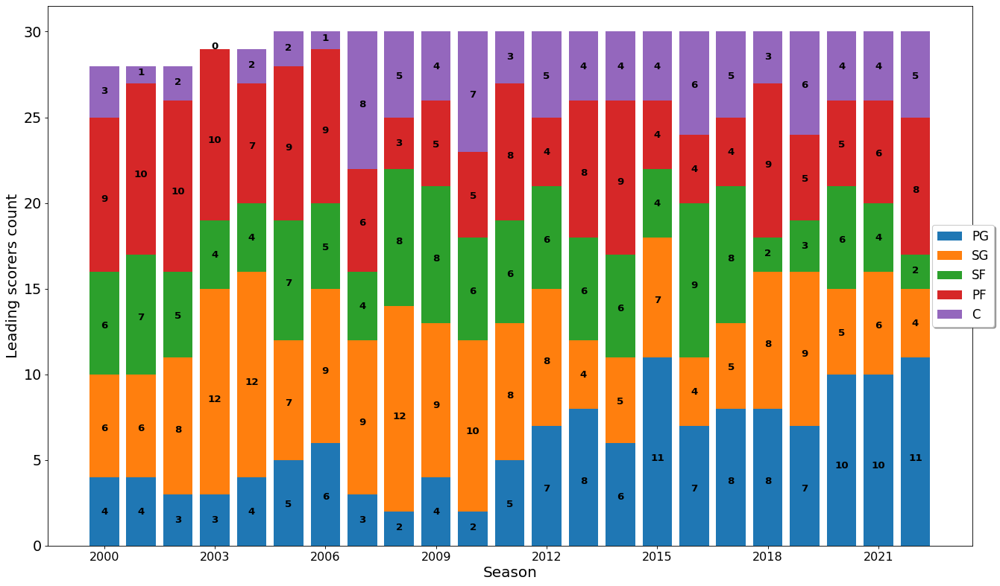

In [45]:
fig, ax = plt.subplots(figsize=(20, 12), dpi=80)

counter = np.zeros(len(SEASONS))

for position in POSITIONS:
    ax.bar(SEASONS, position_with_more_scoring[position], bottom=counter, label=position)
    counter += np.array(position_with_more_scoring[position])
    
for bar in ax.patches:
    ax.text(bar.get_x() + bar.get_width()/2, 
            bar.get_y() + (bar.get_height() * 0.45), 
            round(bar.get_height()), 
            ha='center', color='black', weight='bold', size=12)
    
ax.set_xlabel("Season", fontsize=18)
ax.set_ylabel("Leading scorers count", fontsize=18)
ax.set_xticks(SEASONS[::3])
ax.legend(loc='center left', bbox_to_anchor=(0.95, 0.5),
          fancybox=True, shadow=True, ncol=1, prop={'size': 15})
fig.savefig("Results/PositionsEvolution/Positions_with_most_scoring_with_labels.png", bbox_inches='tight')
plt.show()

### Highest scores with and withou label - average of each 3 seasons

In [46]:
avg_leading_scorers = {}
sd_counter = []

for position in POSITIONS:
    avg_leading_scorers[position] = []
    
    
for position in POSITIONS:
    for i in range(0,len(SEASONS),3):
        a = [position_with_more_scoring[position][i]]
        if i+1 < len(SEASONS):
            a.append(position_with_more_scoring[position][i+1])            
        if i+2 < len(SEASONS):
            a.append(position_with_more_scoring[position][i+2])
        avg_leading_scorers[position].append(mean(a))
        sd_counter.append(np.std(a))

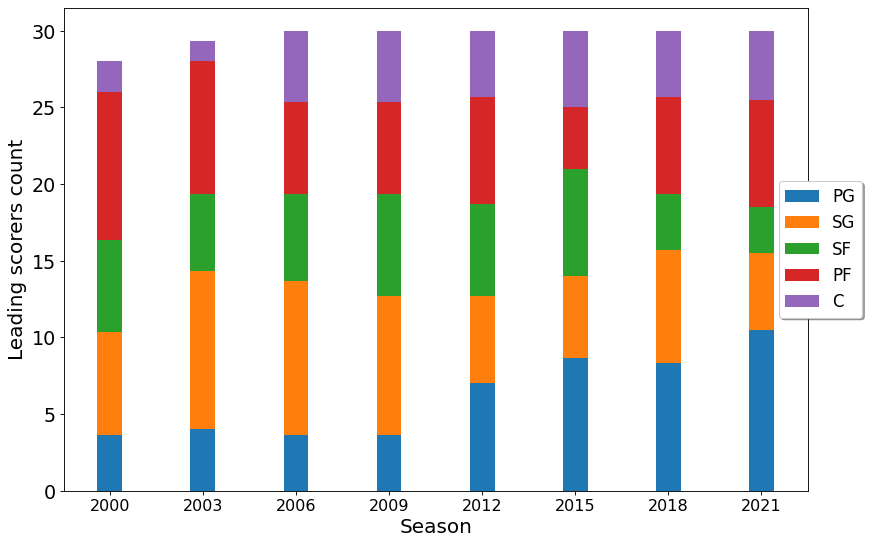

In [47]:
plt.figure(figsize=(12, 8), dpi=80)

counter = np.zeros(len(SEASONS[:-1:3]))

for position in POSITIONS:
    plt.bar(SEASONS[:-1:3], avg_leading_scorers[position], bottom=counter, label=position)
    counter += np.array(avg_leading_scorers[position])

plt.xlabel("Season", fontsize=18)
plt.ylabel("Leading scorers count", fontsize=18)
plt.xticks(SEASONS[:-1:3])
plt.legend(loc='center left', bbox_to_anchor=(0.95, 0.5),
          fancybox=True, shadow=True, ncol=1, prop={'size': 15})
plt.savefig("Results/PositionsEvolution/Positions_with_most_scoring_averaged.png", bbox_inches='tight')
plt.show()

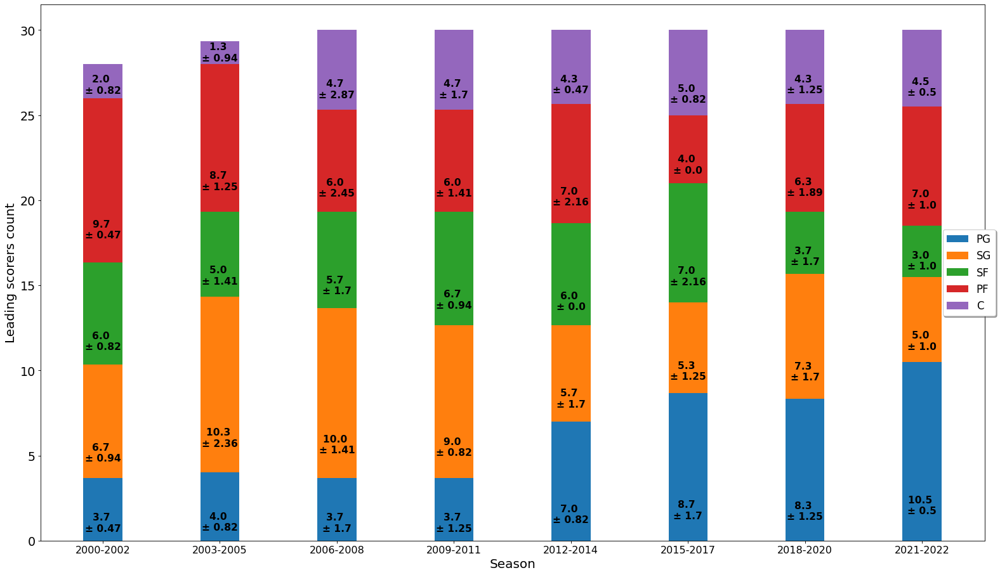

In [48]:
fig, ax = plt.subplots(figsize=(24, 14), dpi=80)

counter = np.zeros(len(SEASONS[:-1:3]))

for position in POSITIONS:
    ax.bar(SEASONS[:-1:3], avg_leading_scorers[position], width=1, bottom=counter, label=position)
    counter += np.array(avg_leading_scorers[position])
    
counter = 0
for bar in ax.patches:
    ax.text(bar.get_x() + bar.get_width()/2, 
            bar.get_y() + (bar.get_height() * 0.15), 
            f'{round(bar.get_height(),1)} \n\u00B1 {round(sd_counter[counter], 2)}', 
            ha='center', color='black', weight='bold', size=14)
    counter += 1
    
ax.set_xlabel("Season", fontsize=18)
ax.set_ylabel("Leading scorers count", fontsize=18)
ax.set_xticks(SEASONS[:-1:3],labels=['2000-2002', '2003-2005', '2006-2008', '2009-2011', '2012-2014', '2015-2017', '2018-2020', '2021-2022'])
ax.legend(loc='center left', bbox_to_anchor=(0.95, 0.5),
          fancybox=True, shadow=True, ncol=1, prop={'size': 15})
fig.savefig("Results/PositionsEvolution/Positions_with_most_scoring_with_labels_averaged.png", bbox_inches='tight')
plt.show()

# Analyzing the impact of positions by average stats

In [49]:
avg_by_pos = []

for i in range(len(SEASONS[:])):
    first_year, second_year = format_season(SEASONS[i])
    df = player_dfs[i].sort_values(by=['G'], ascending=False)
    df = df[df["Tm"] != "TOT"]
    df = df[df["MP"] >= 5]
    max_g = df.max()['G']
    df = df[df['G'] >= max_g / 2]
    df = pd.DataFrame(df.groupby(by=['Pos']).mean())
    avg_by_pos.append(df)
    #df.to_csv("DataCollection/Positions/AverageStatsByPositon_{0}-{1}.csv".format(first_year, second_year))
    
    

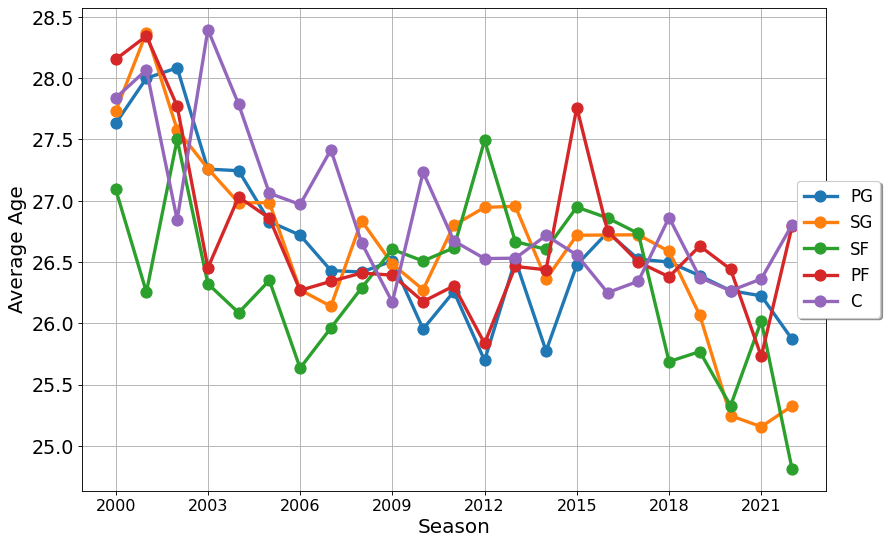

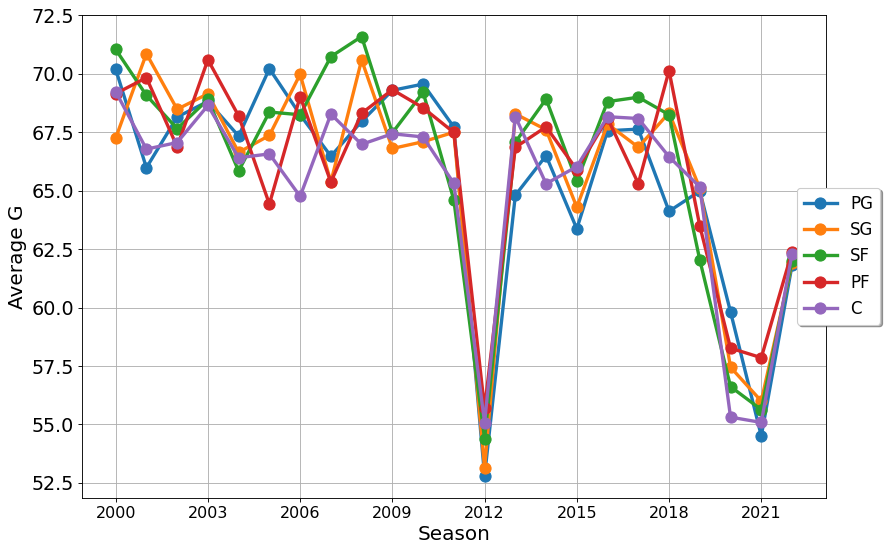

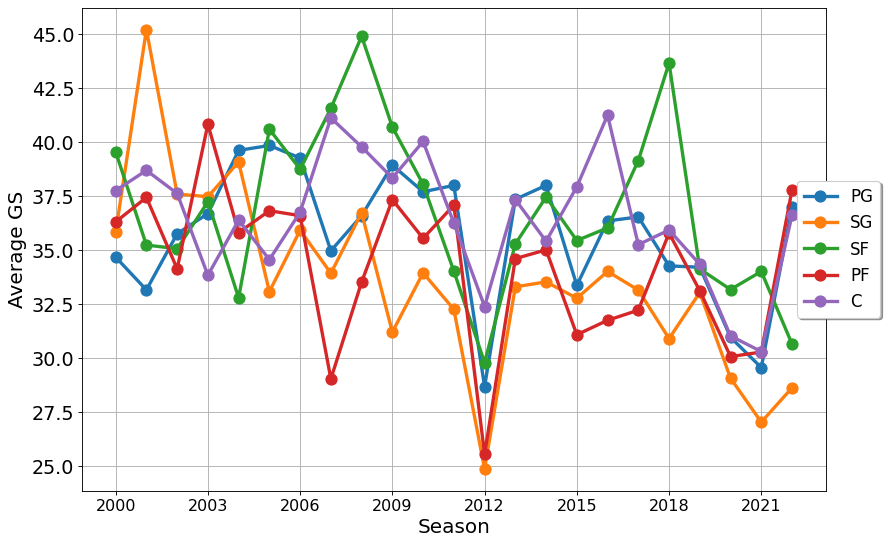

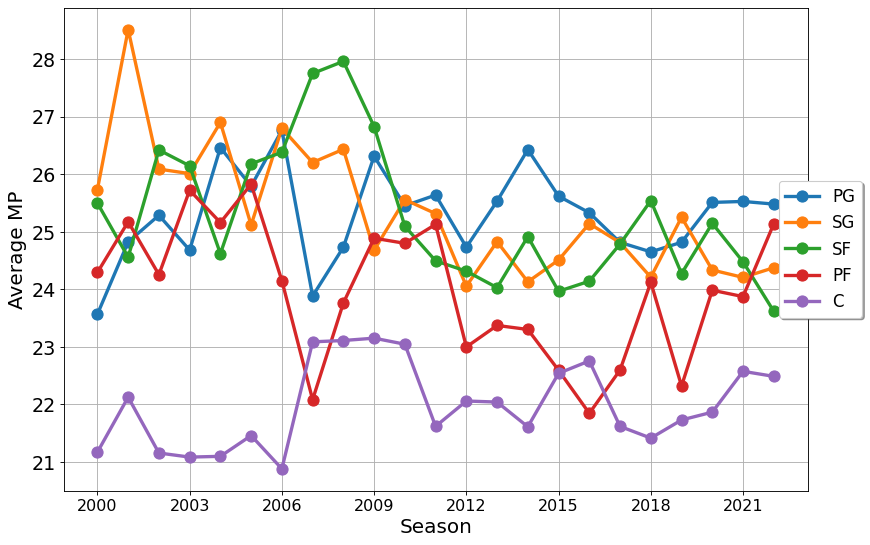

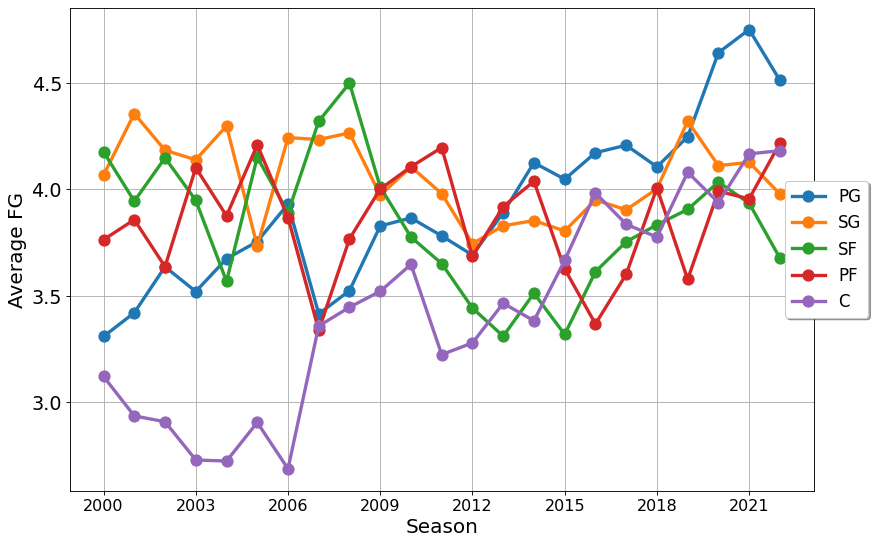

...

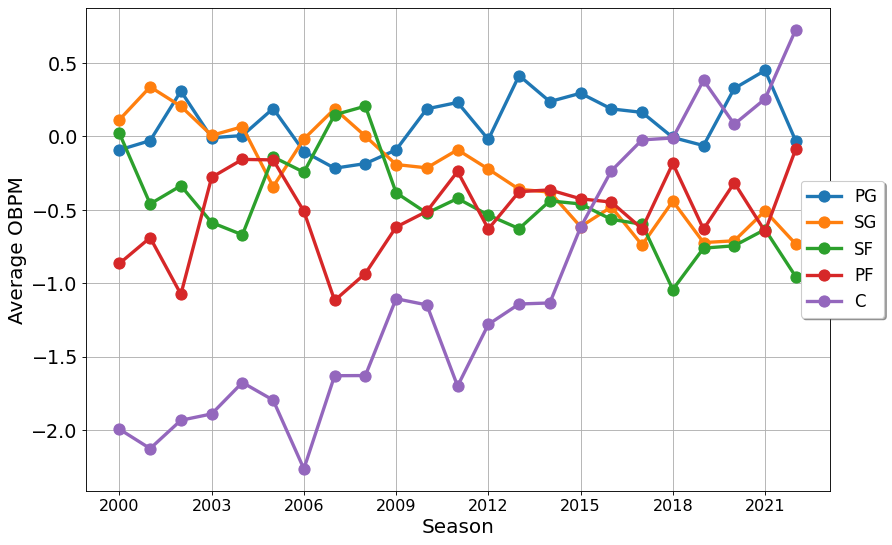

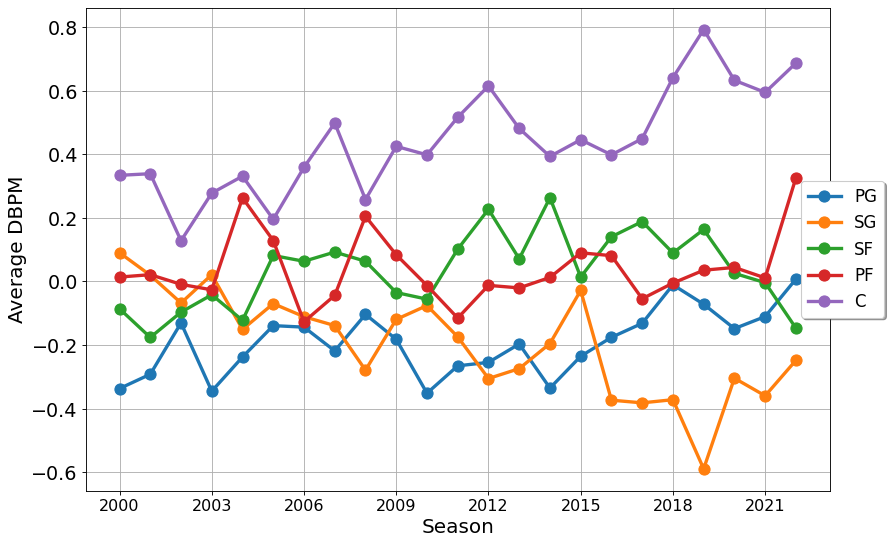

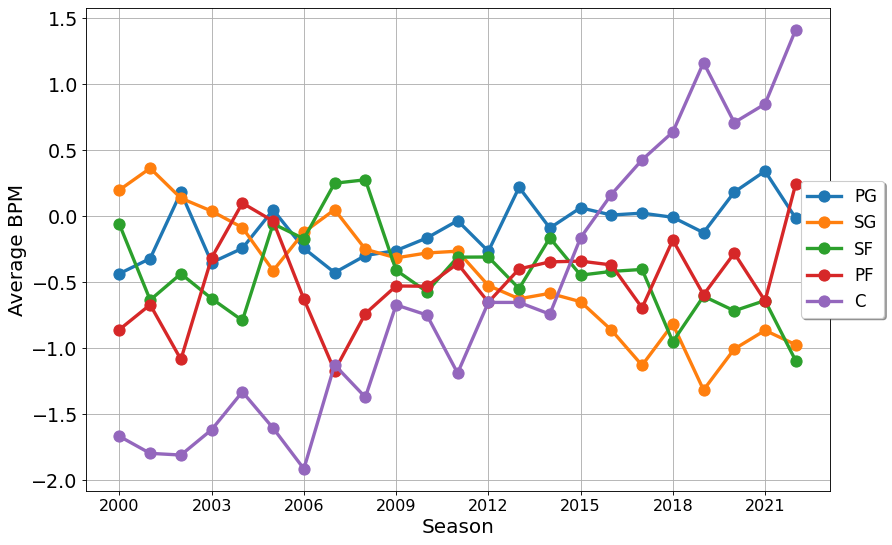

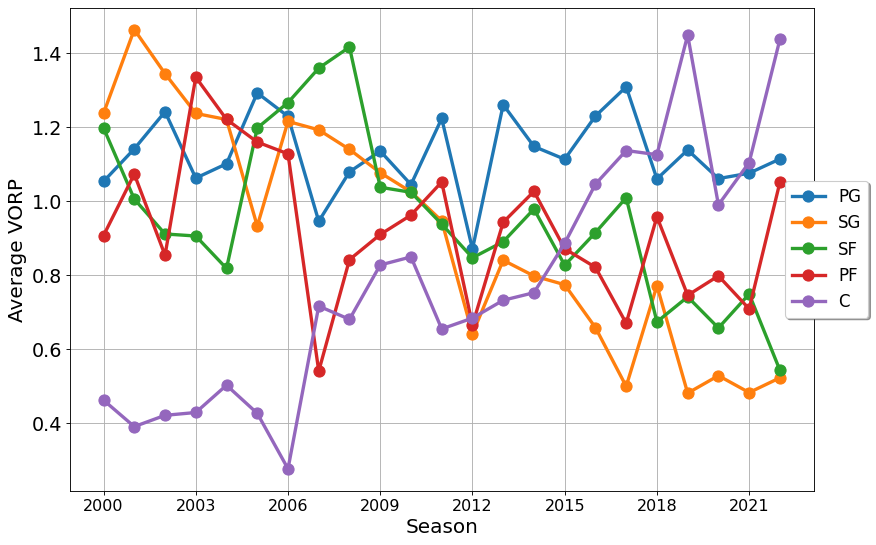

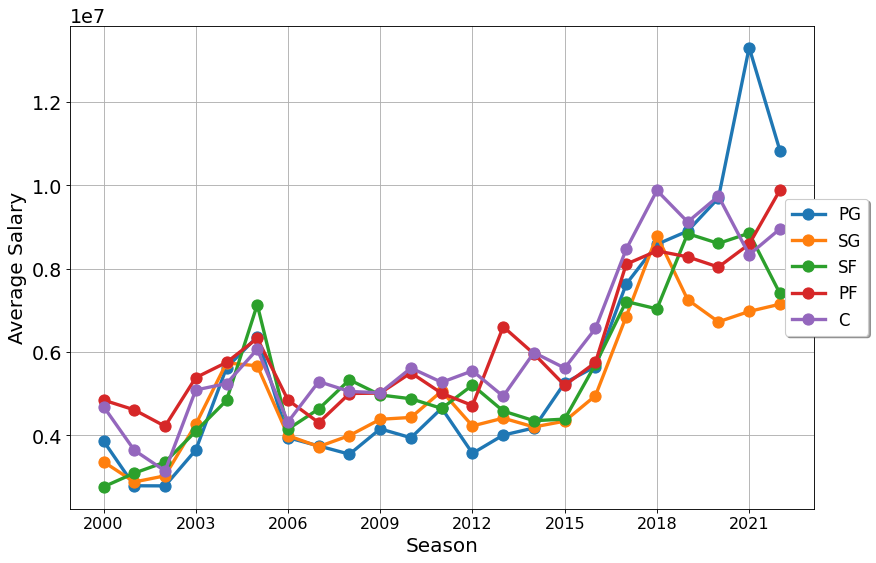

In [50]:
stats = avg_by_pos[0].columns
for stat in stats:
    avg_by_pos_each_season = get_stat_by_position_each_season(stat, avg_by_pos)
    plot_position_graph(avg_by_pos_each_season, stat, "Average", SEASONS)

In [51]:
sd_by_pos = []

for i in range(len(SEASONS[:])):
    first_year, second_year = format_season(SEASONS[i])
    df = player_dfs[i].sort_values(by=['G'], ascending=False)
    df = df[df["Tm"] != "TOT"]
    df = df[df["MP"] >= 5]
    df = df.drop_duplicates(subset ="Player",keep = "first")
    df = pd.DataFrame(df.groupby(by=['Pos']).std())
    df.sort_values(by='PTS', ascending=False, inplace=True)
    sd_by_pos.append(df)
#     df.to_csv("DataCollection/Positions/StandardDeviationStatsByPositon_{0}-{1}.csv".format(first_year, second_year))
    
    

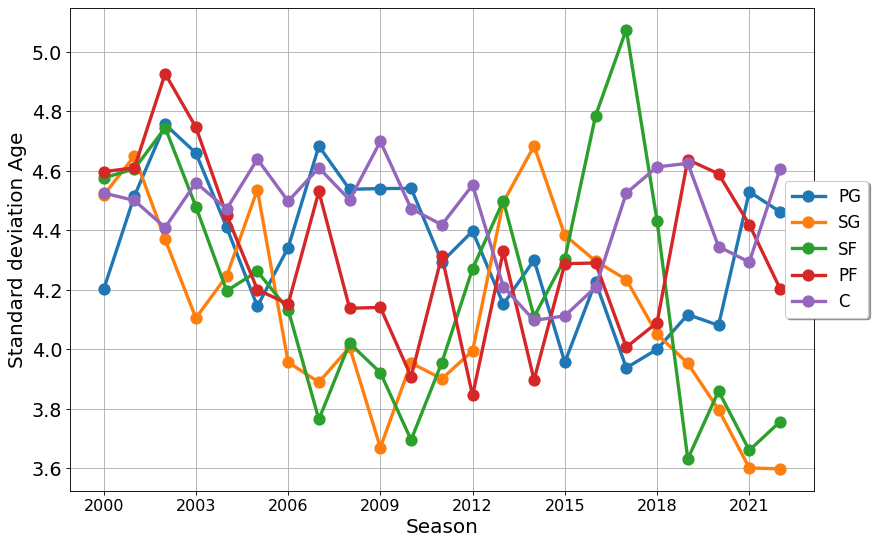

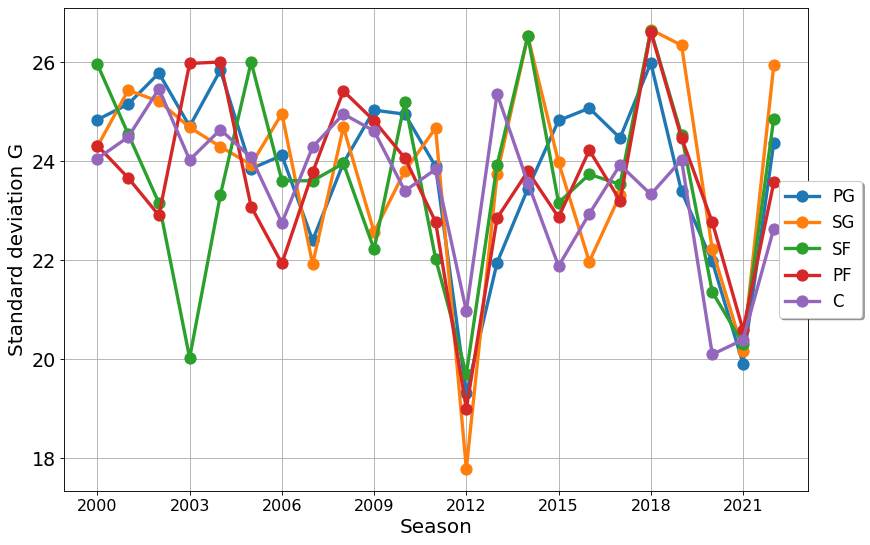

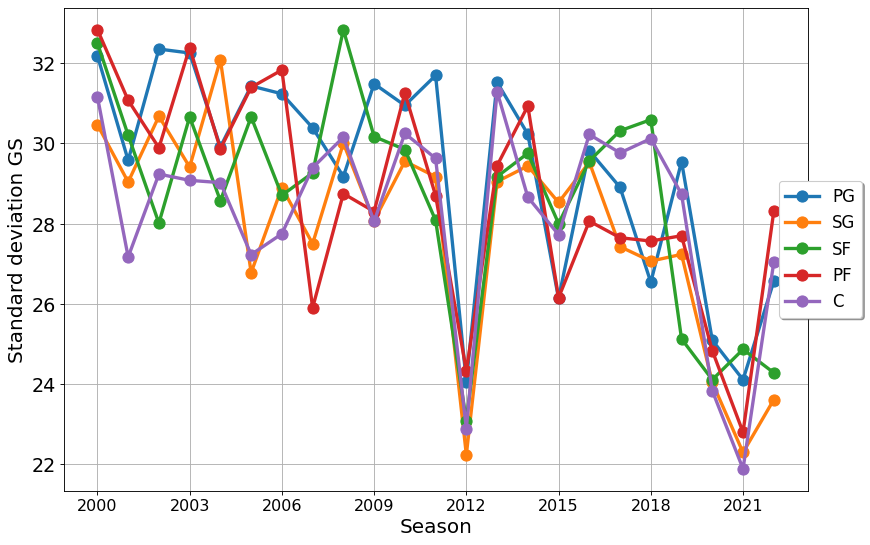

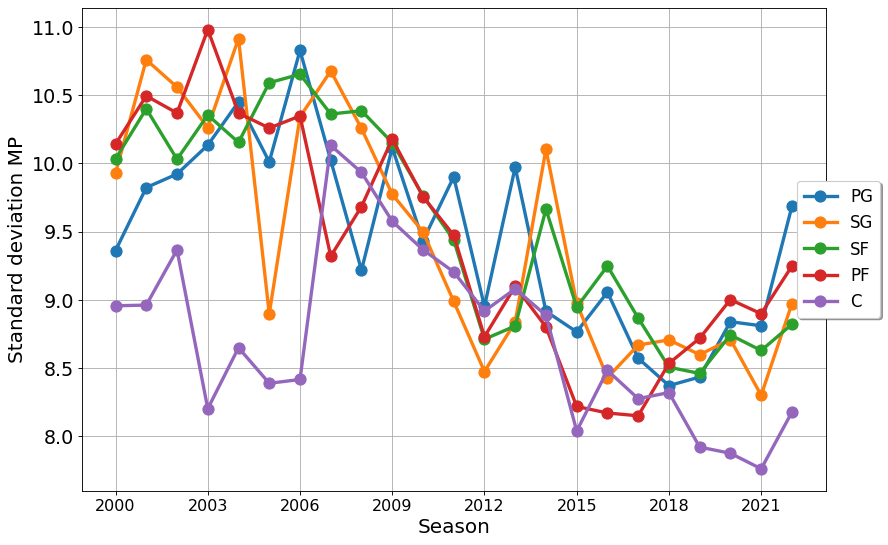

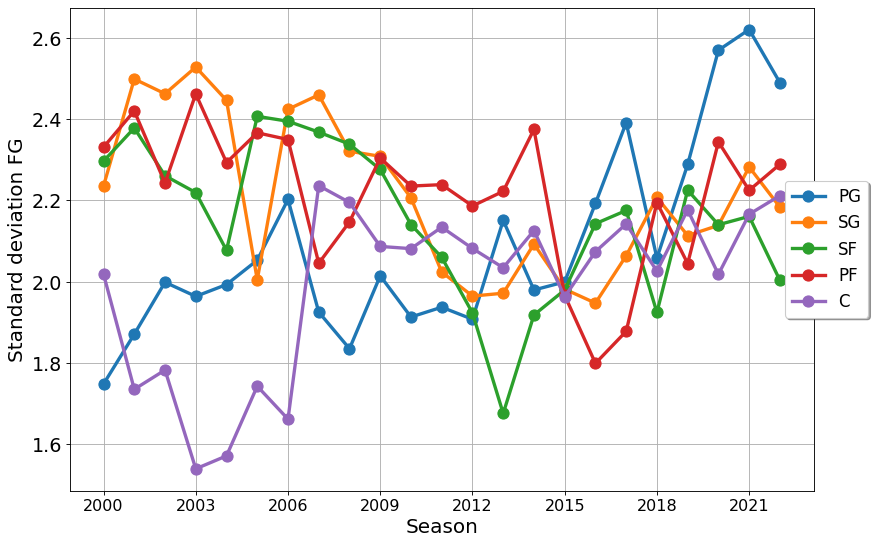

...

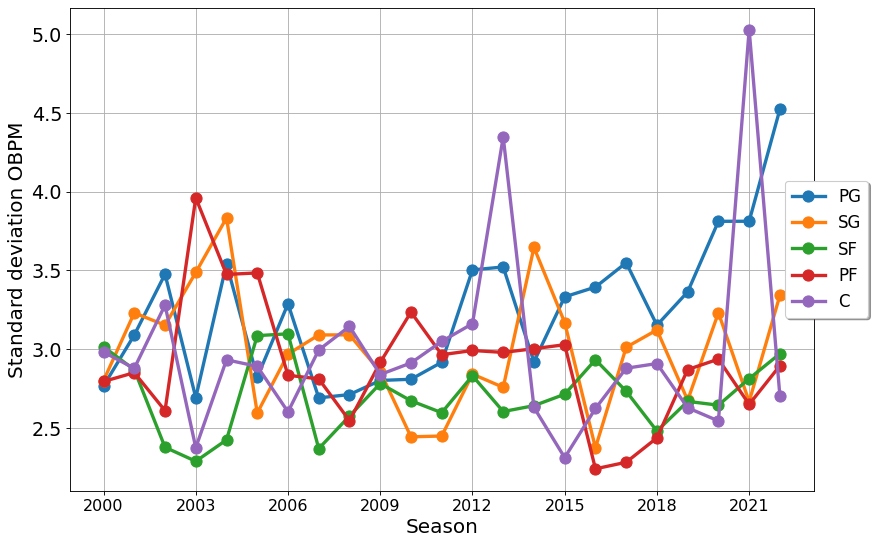

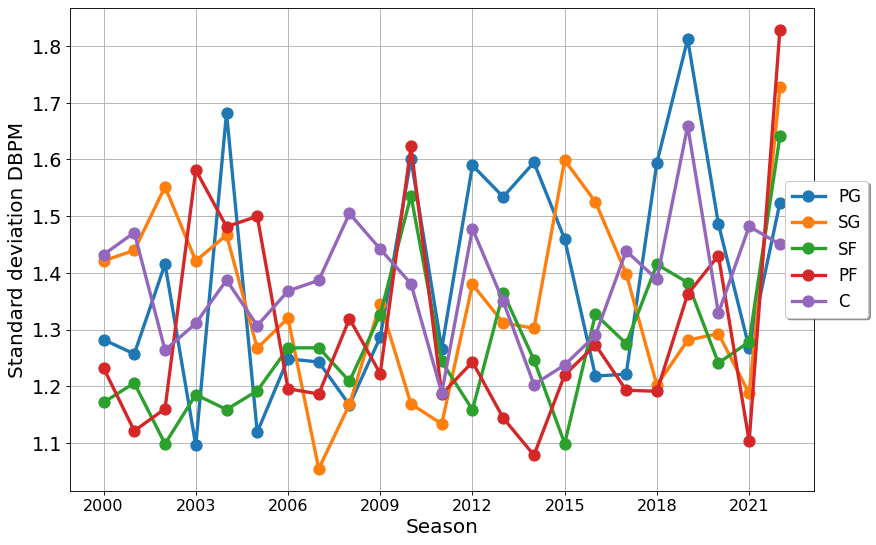

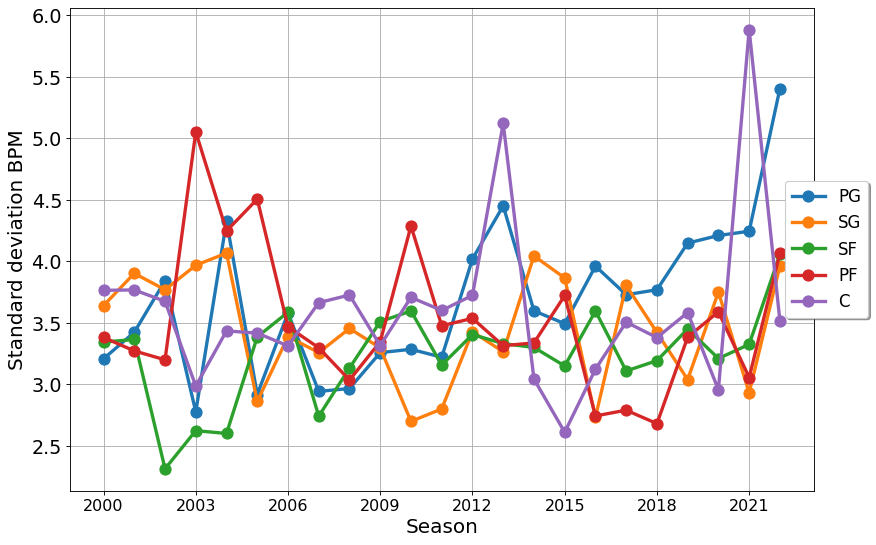

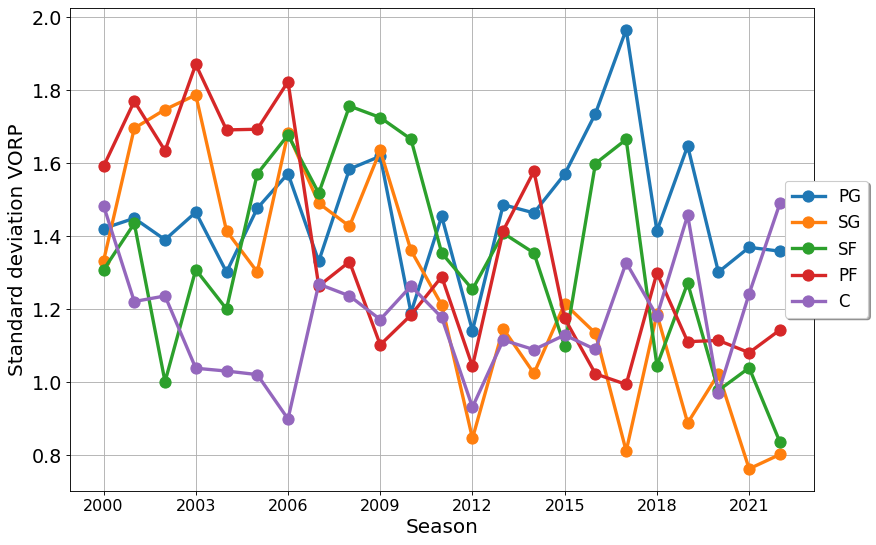

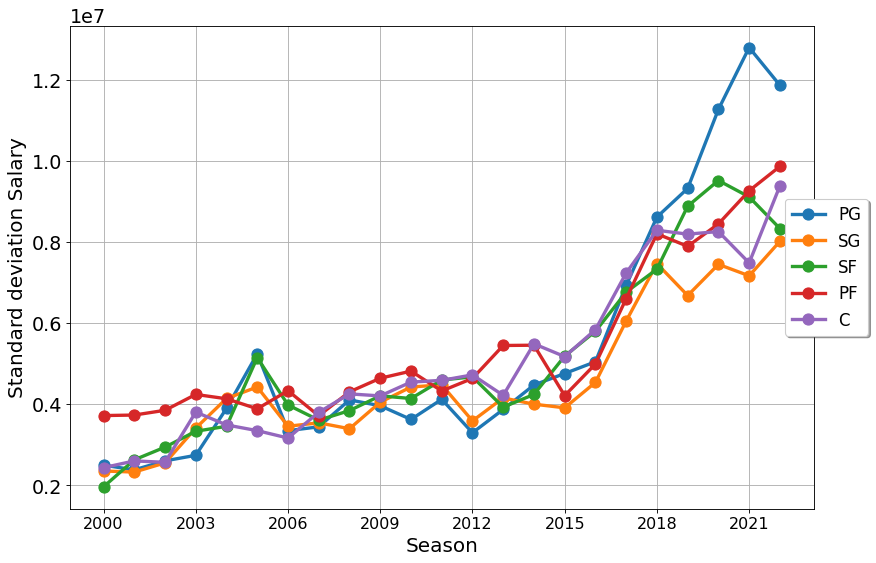

In [52]:
stats = sd_by_pos[0].columns
for stat in stats:
    sd_by_pos_each_season = get_stat_by_position_each_season(stat, sd_by_pos)
    plot_position_graph(sd_by_pos_each_season, stat, "Standard deviation", SEASONS)

In [53]:
median_by_pos = []

for i in range(len(SEASONS[:])):
    first_year, second_year = format_season(SEASONS[i])
    df = player_dfs[i].sort_values(by=['G'], ascending=False)
    df = df[df["Tm"] != "TOT"]
    df = df[df["MP"] >= 5]
    df = df.drop_duplicates(subset ="Player",keep = "first")
    df = pd.DataFrame(df.groupby(by=['Pos']).median())
    df.sort_values(by='PTS', ascending=False, inplace=True)
    median_by_pos.append(df)
#     df.to_csv("DataCollection/Positions/StandardDeviationStatsByPositon_{0}-{1}.csv".format(first_year, second_year))
    
    

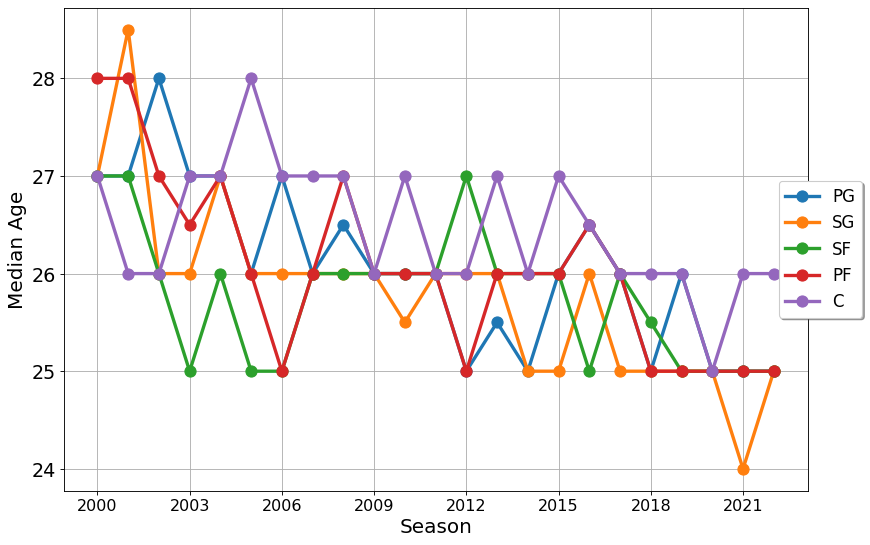

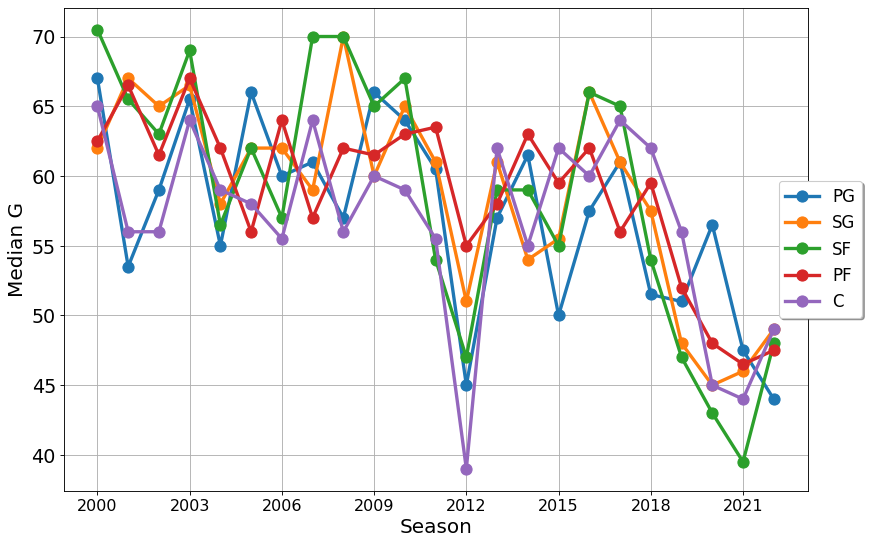

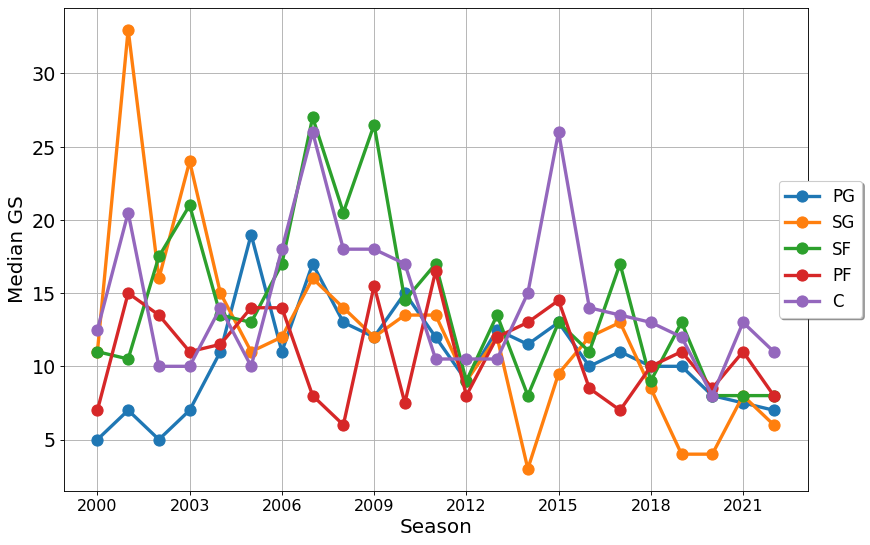

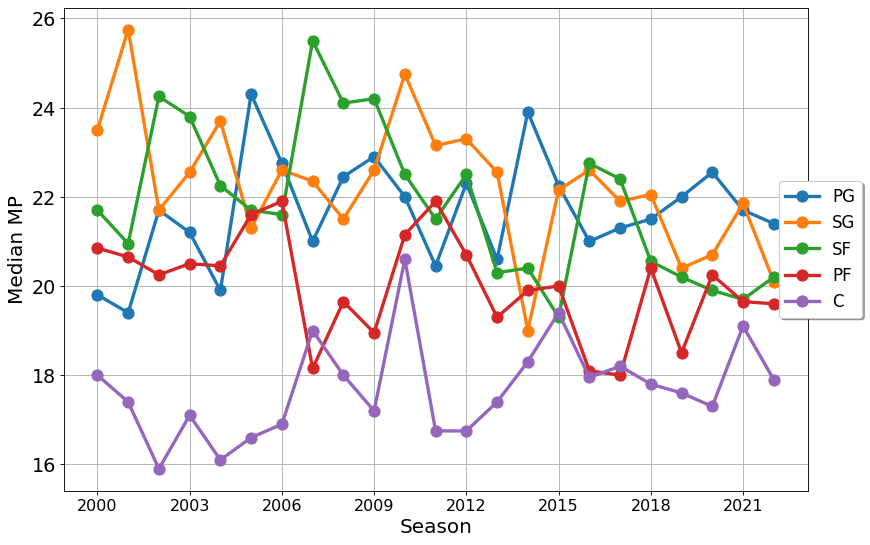

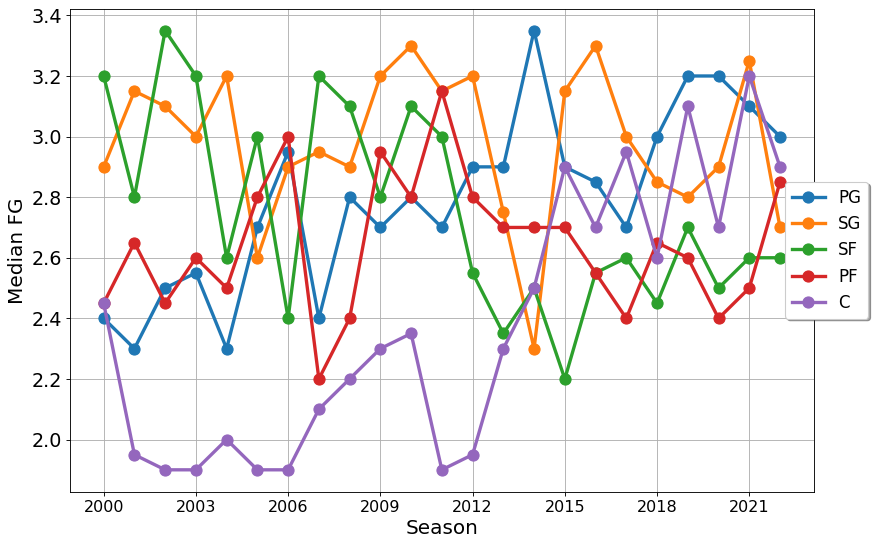

...

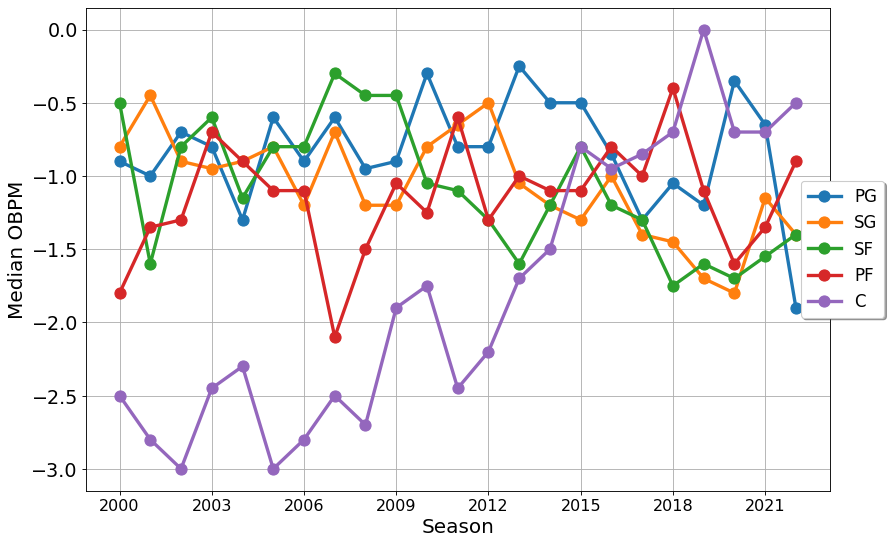

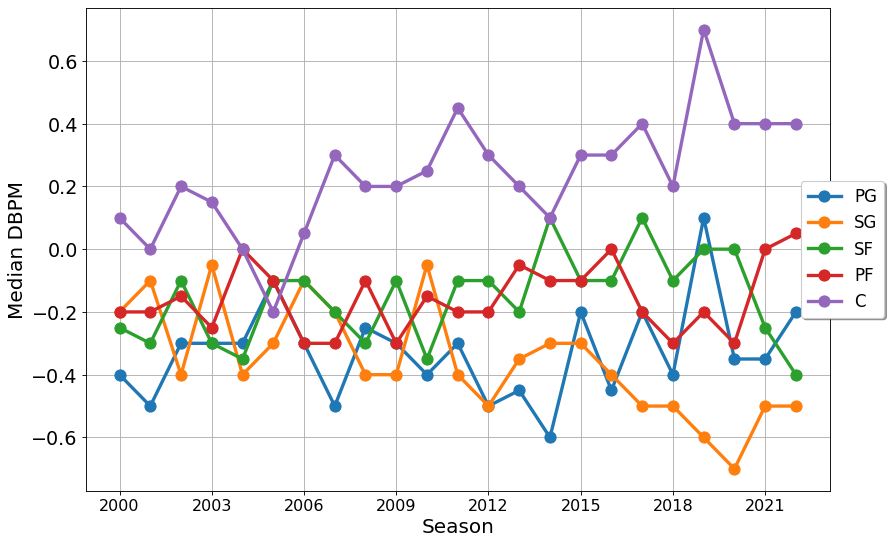

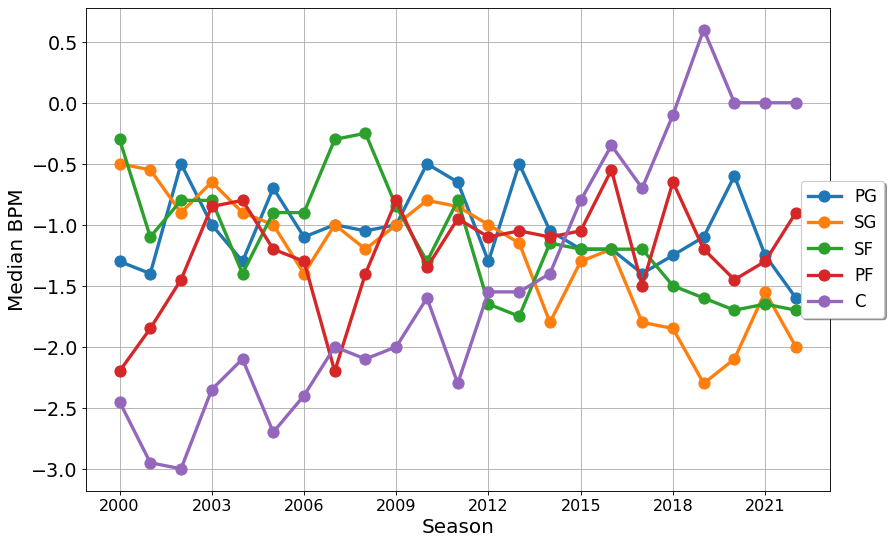

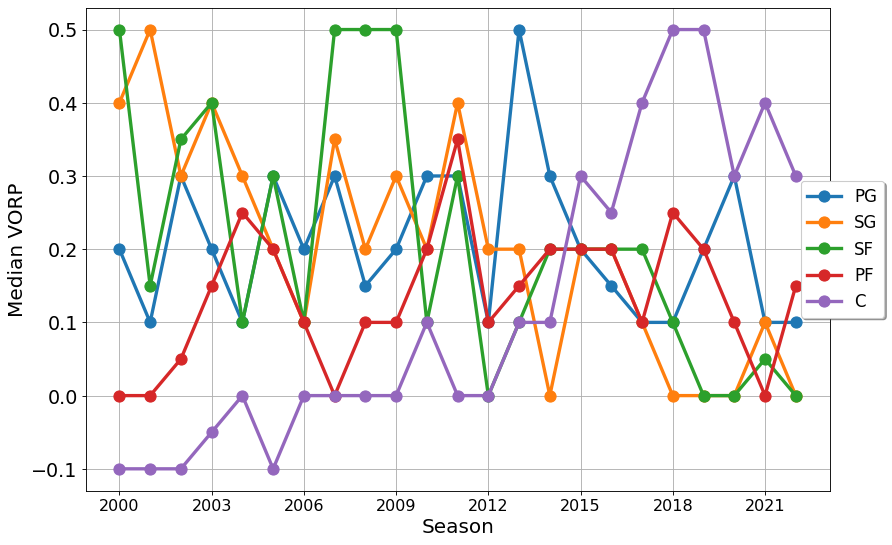

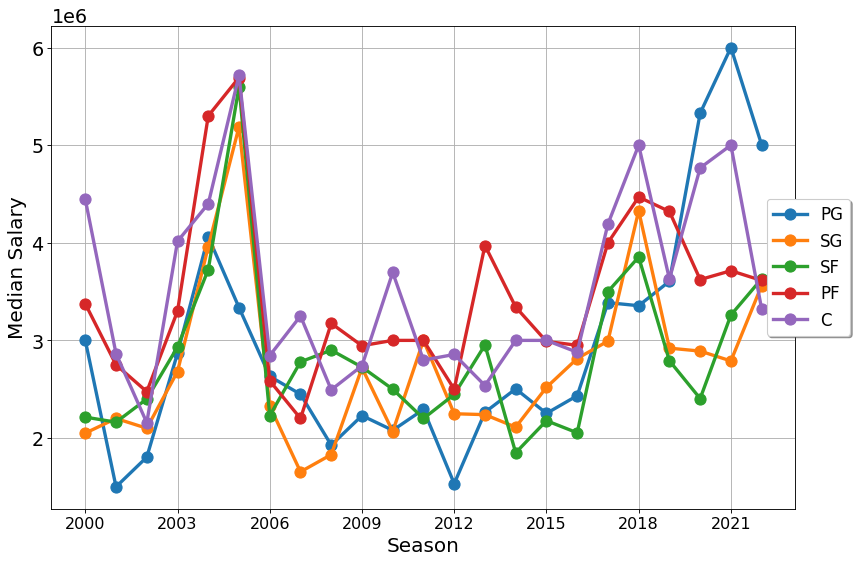

In [54]:
stats = median_by_pos[0].columns
for stat in stats:
    median_by_pos_each_season = get_stat_by_position_each_season(stat, median_by_pos)
    plot_position_graph(median_by_pos_each_season, stat, "Median", SEASONS)

## Same analysis, but grouping every 3 seasons to reduce visual information

In [55]:
avg_by_pos_compact = group_seasons(player_dfs, SEASONS, "Mean")    

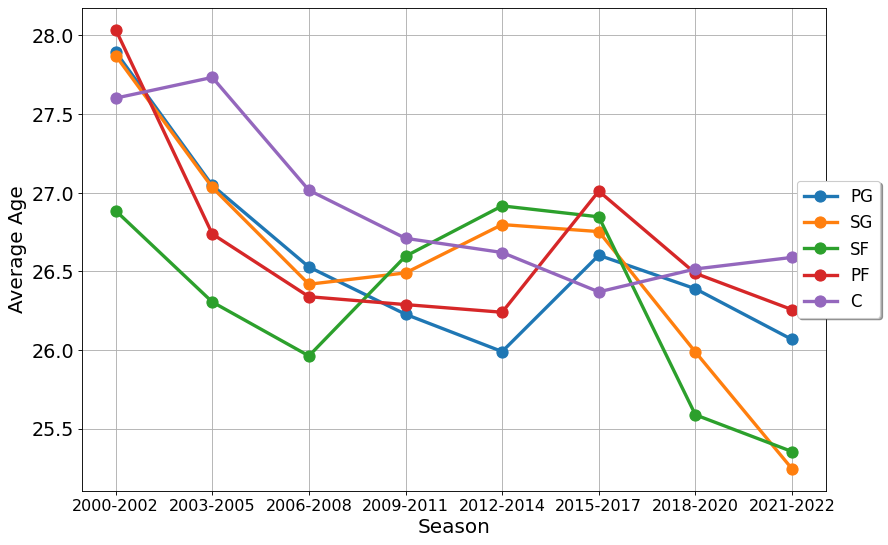

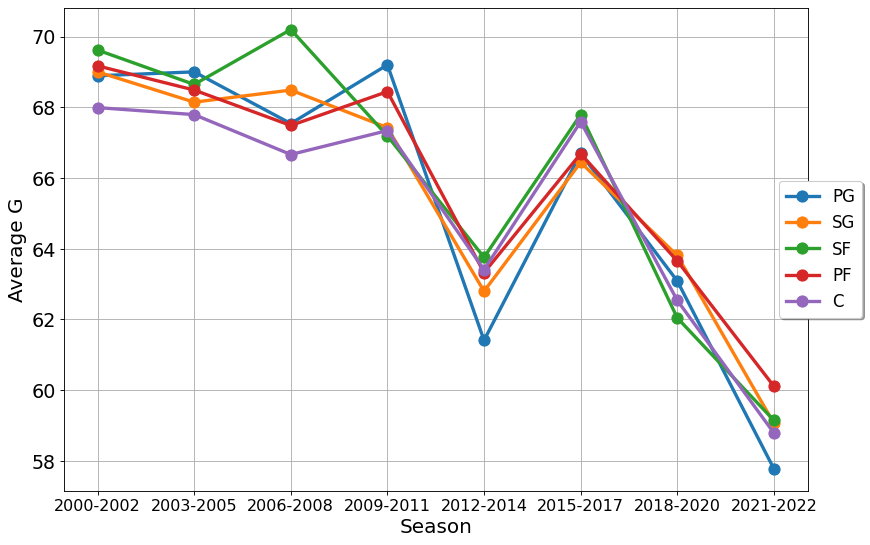

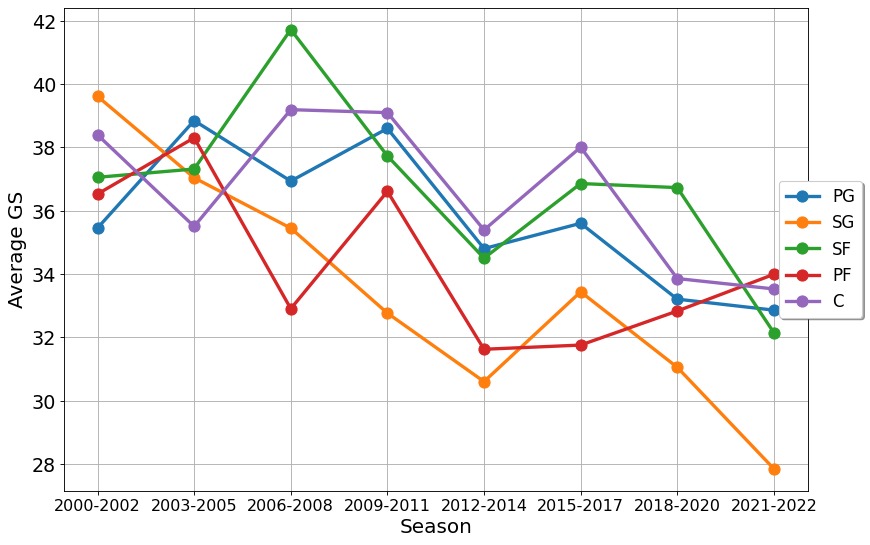

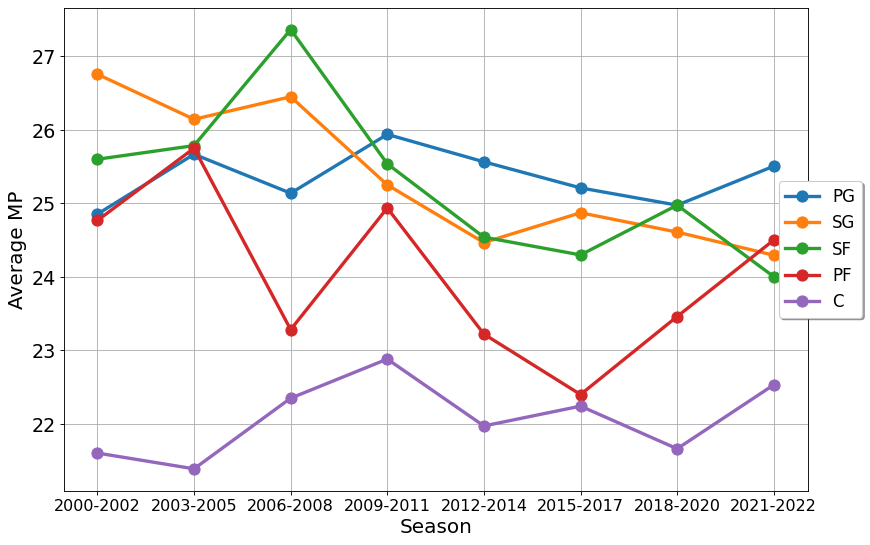

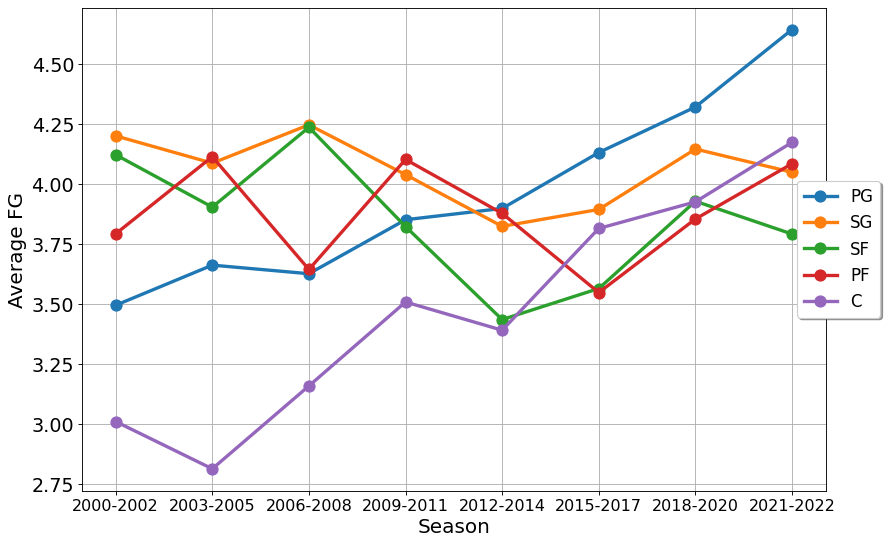

...

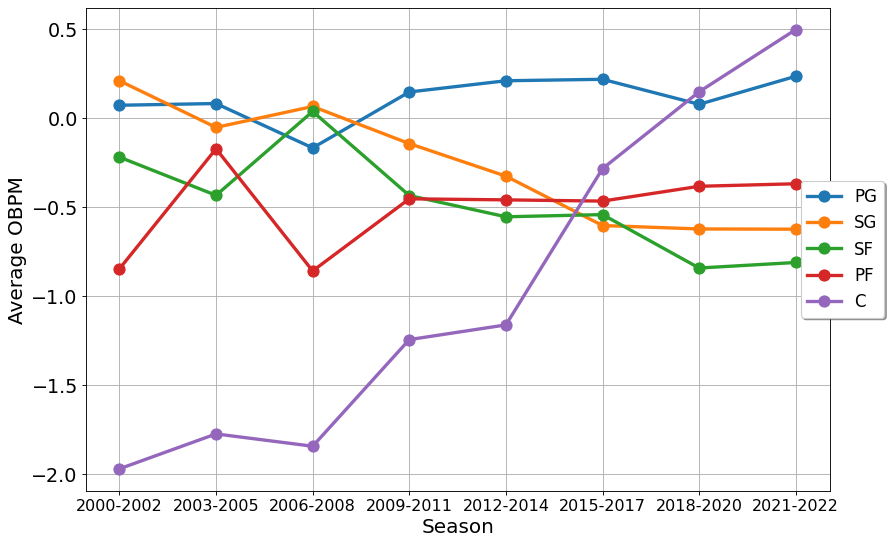

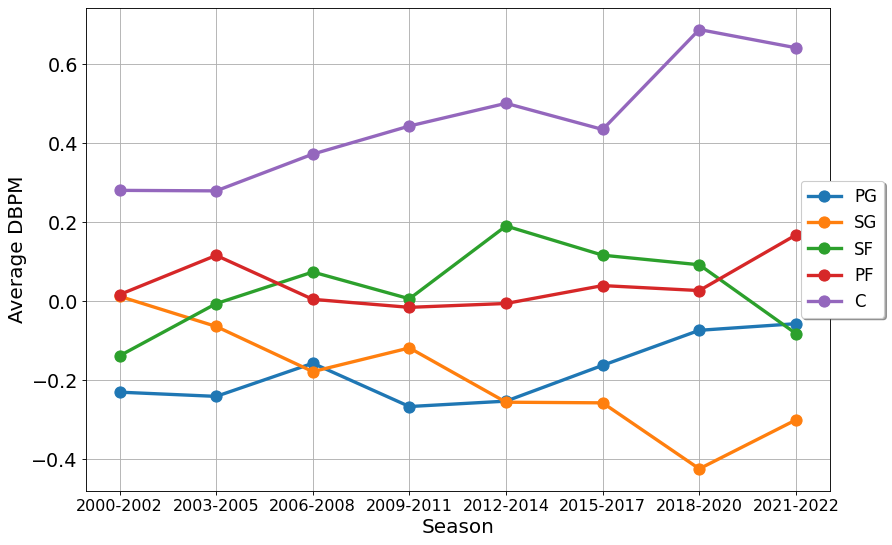

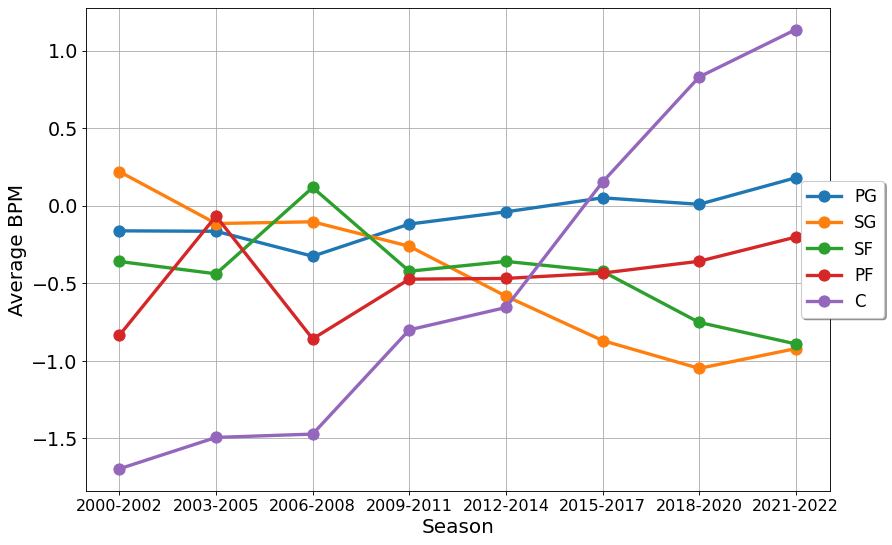

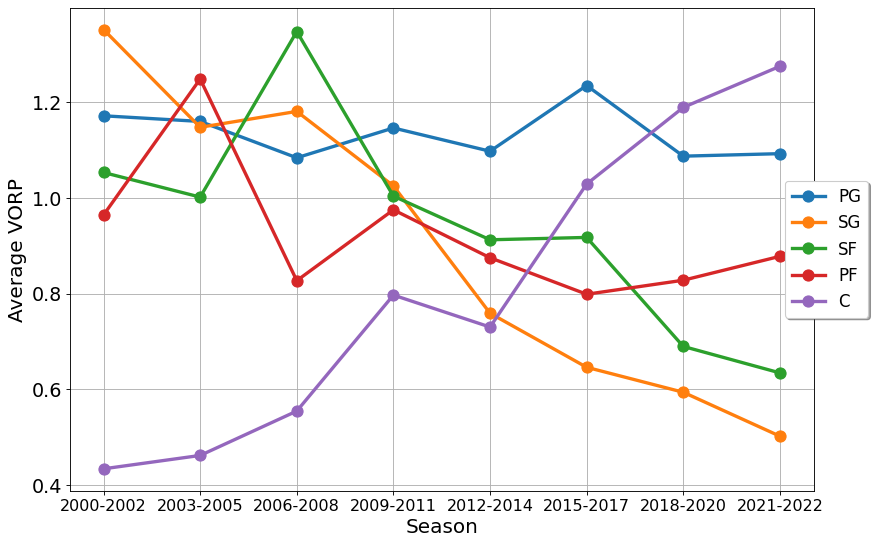

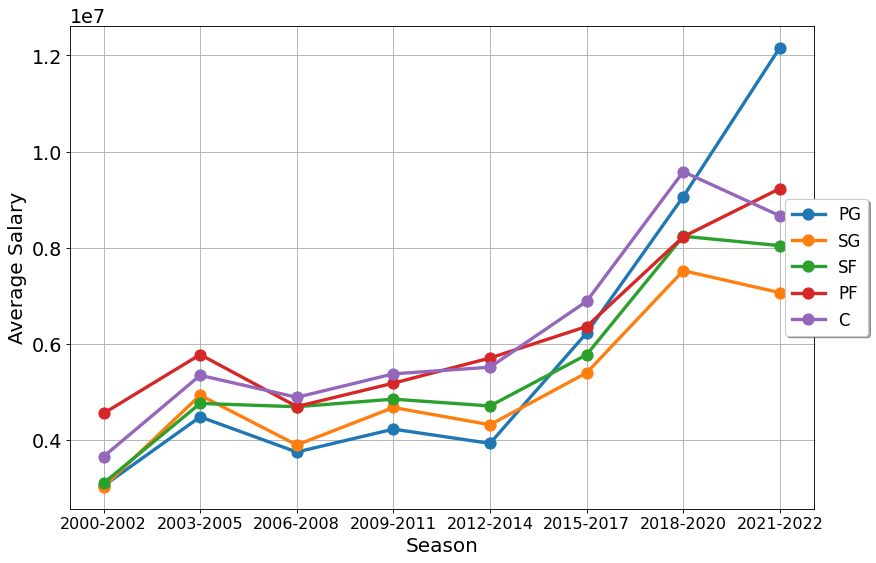

In [56]:
stats = avg_by_pos_compact[0].columns
for stat in stats:
    avg_by_pos_grouped_seasons = get_stat_by_position_each_season(stat, avg_by_pos_compact)
    plot_position_graph_grouped_seasons(avg_by_pos_grouped_seasons, stat, "Average", SEASONS)

In [57]:
sd_by_pos_compact = group_seasons(player_dfs, SEASONS, "Sd")     

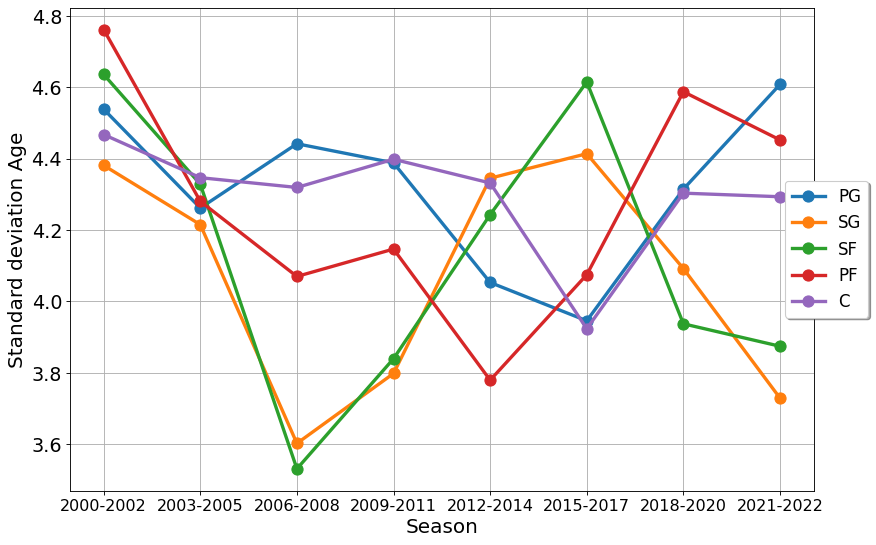

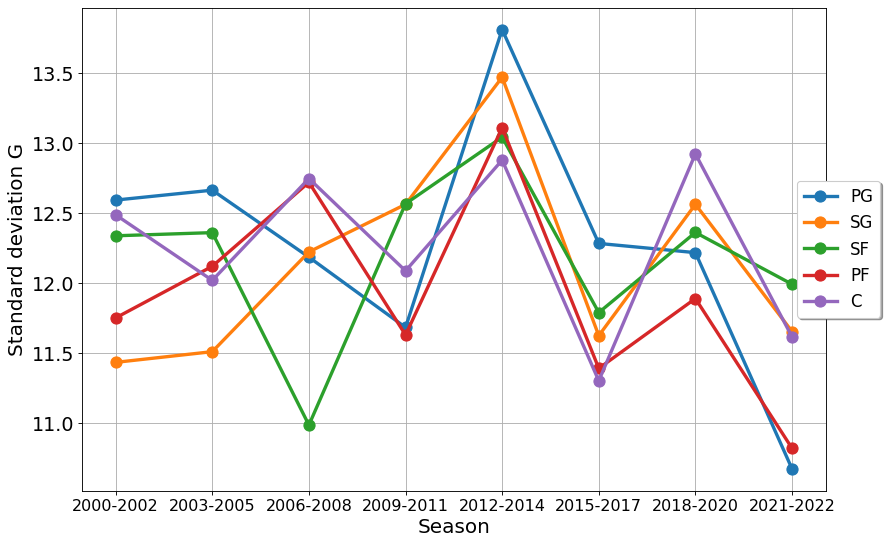

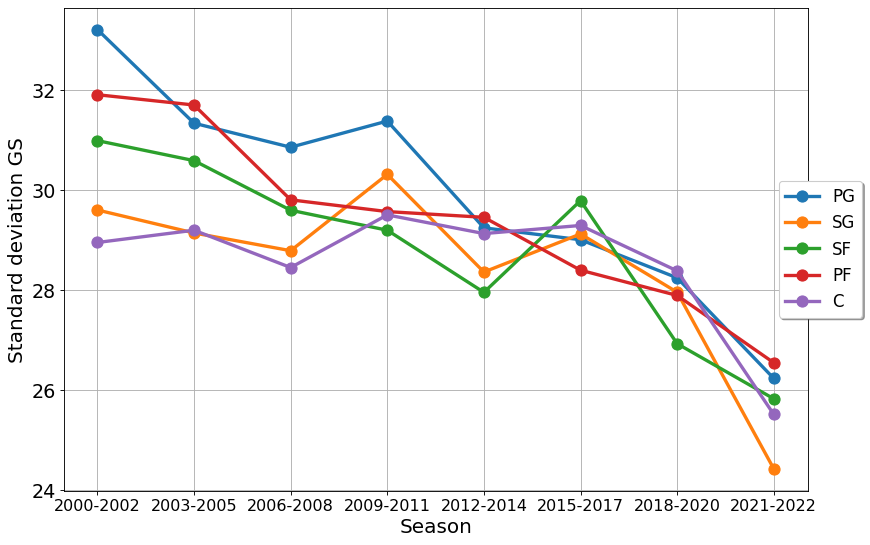

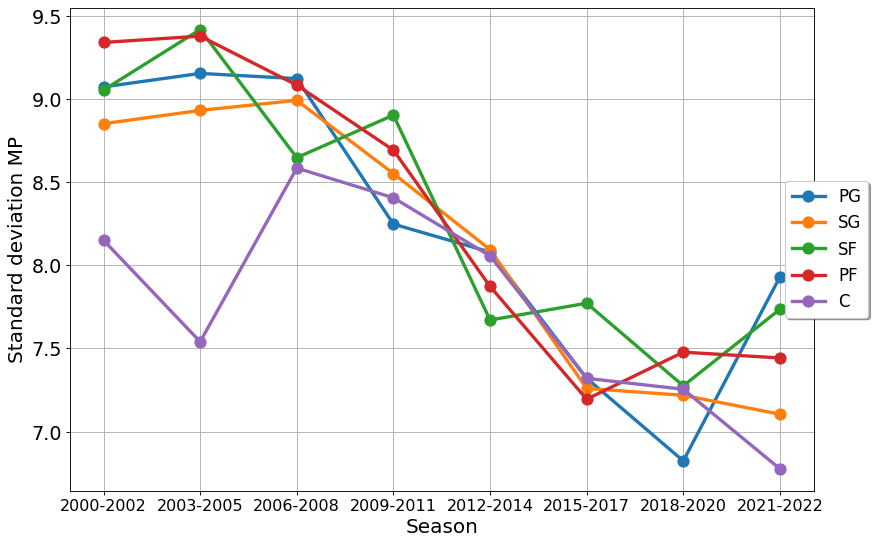

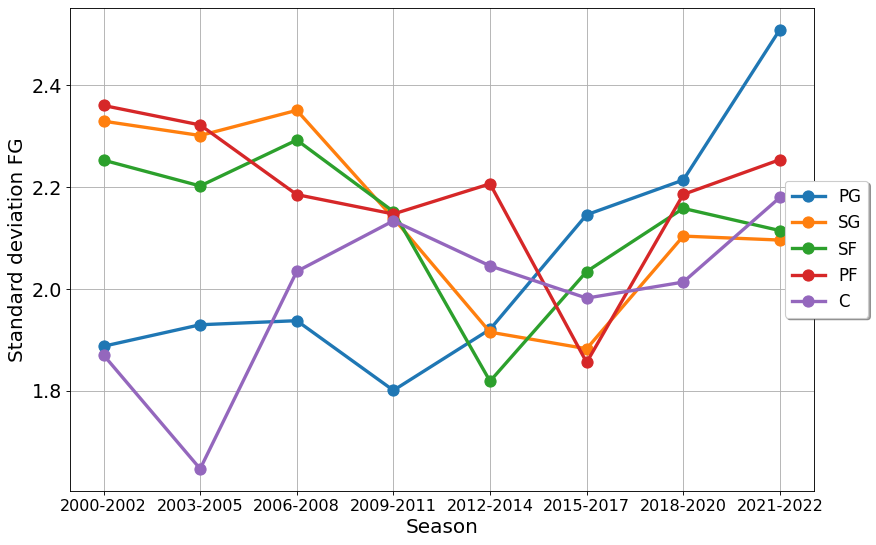

...

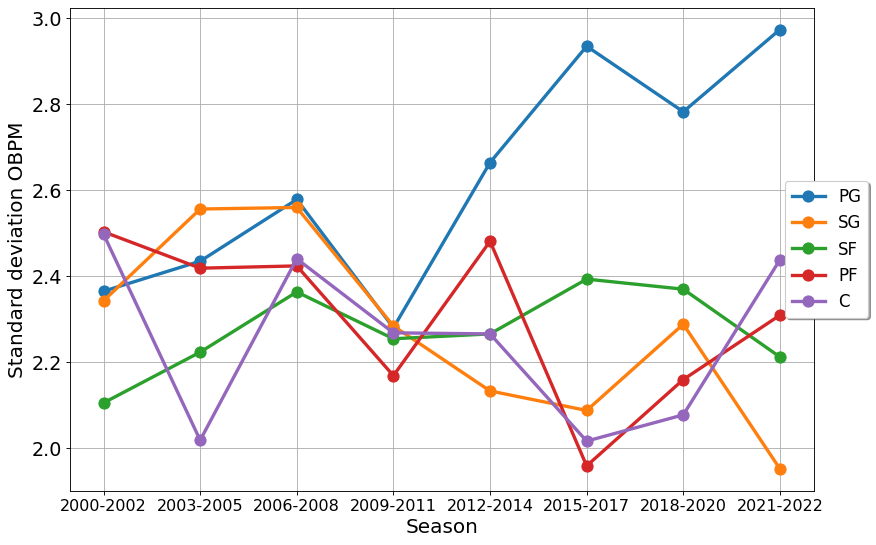

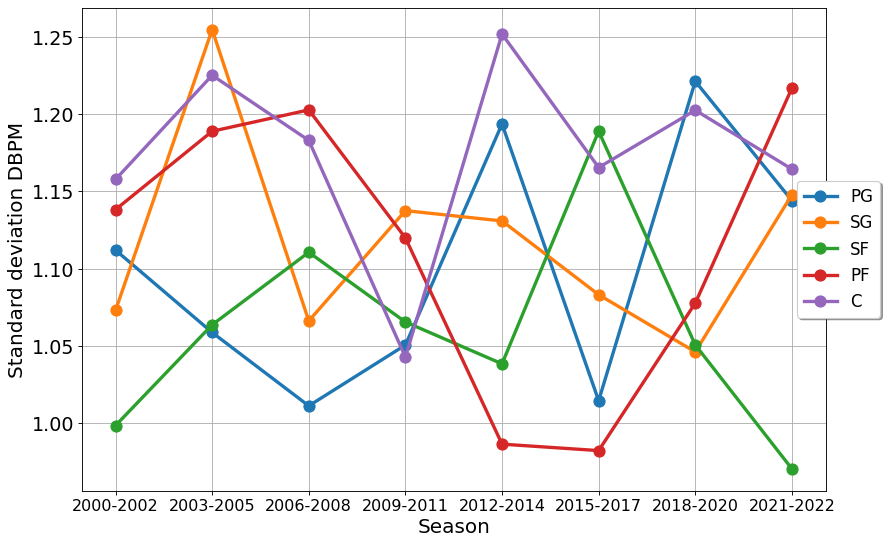

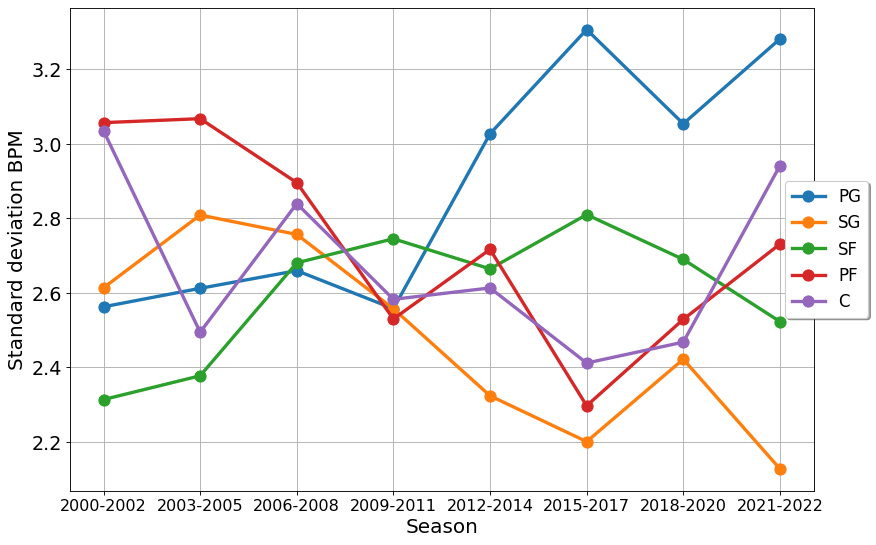

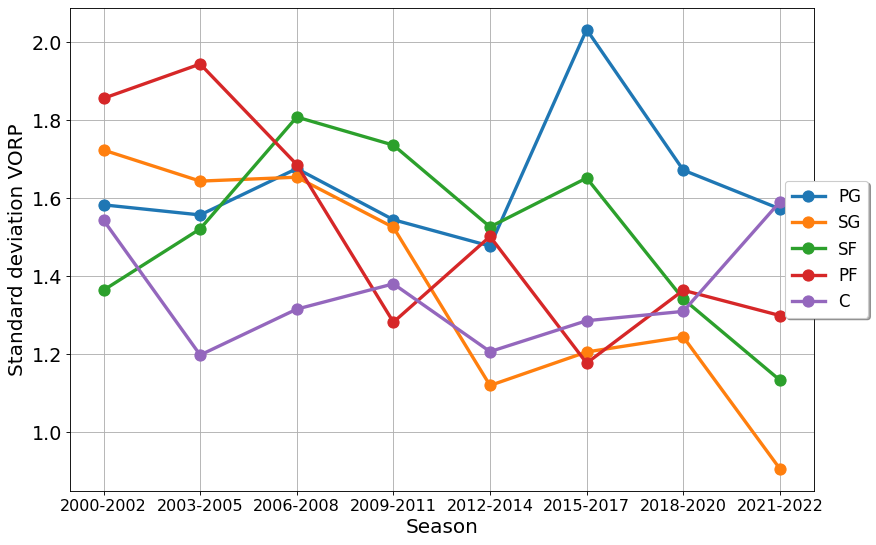

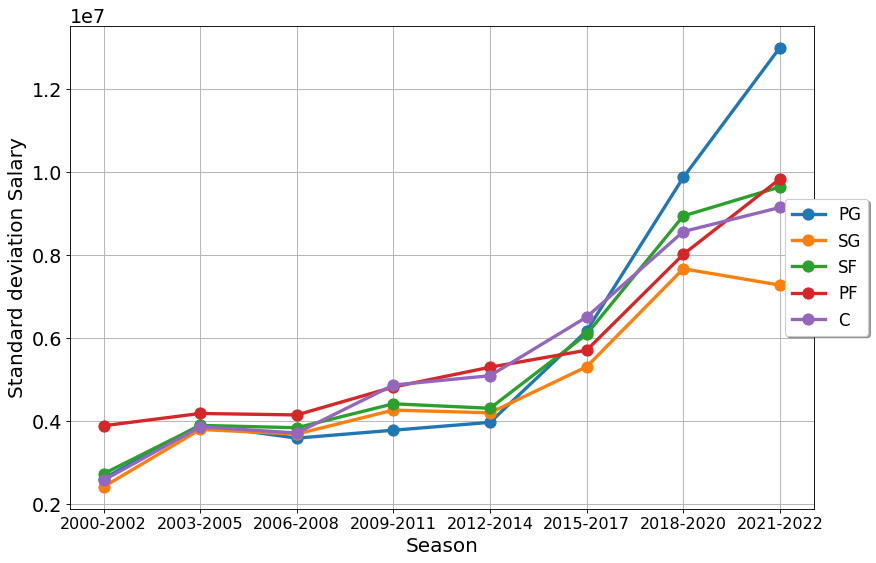

In [58]:
stats = sd_by_pos_compact[0].columns
for stat in stats:
    sd_by_pos_grouped_season = get_stat_by_position_each_season(stat, sd_by_pos_compact)
    plot_position_graph_grouped_seasons(sd_by_pos_grouped_season, stat, "Standard deviation", SEASONS)

In [59]:
median_by_pos_compact = group_seasons(player_dfs, SEASONS, "Median")    

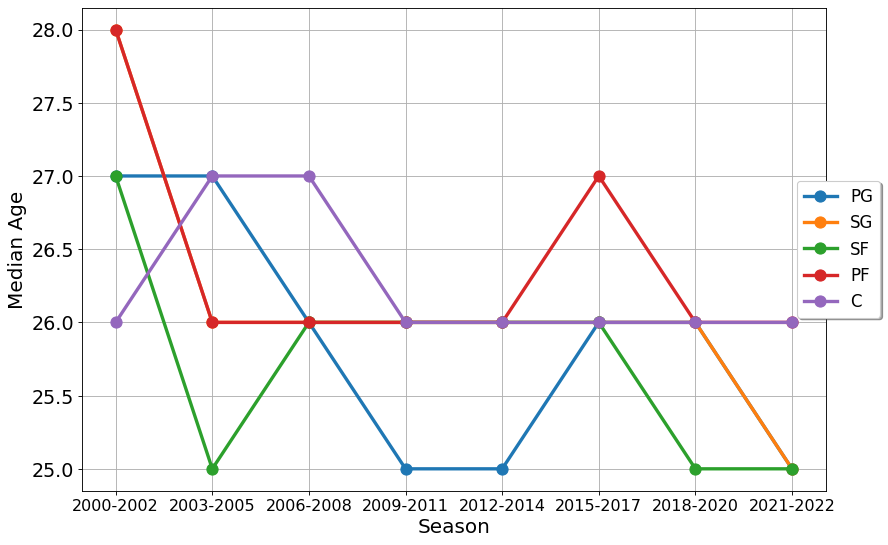

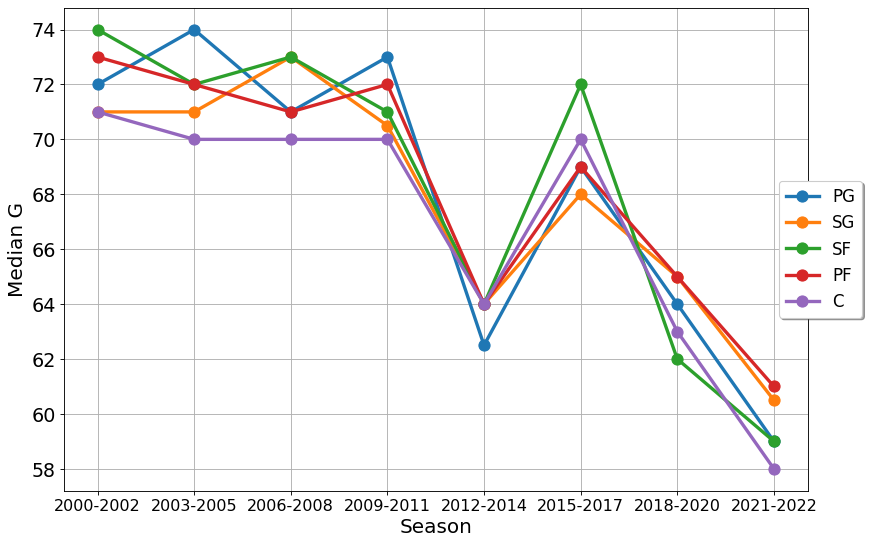

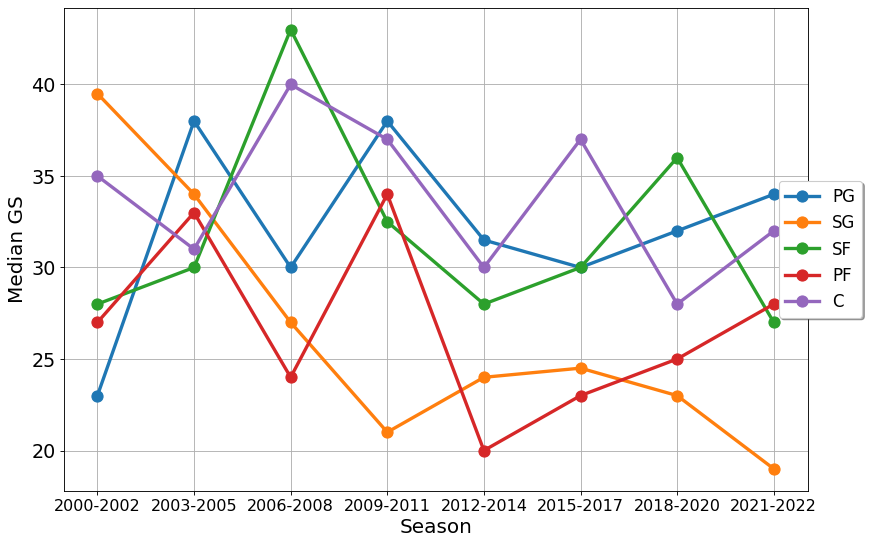

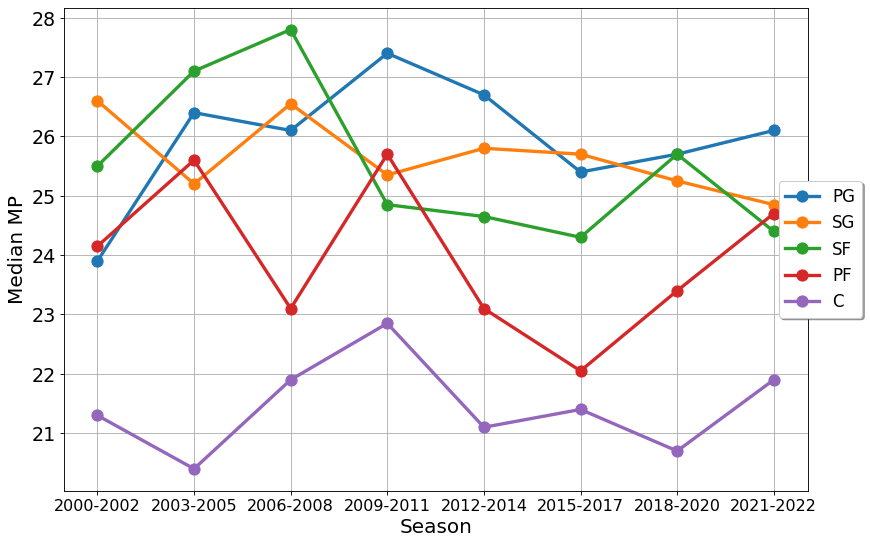

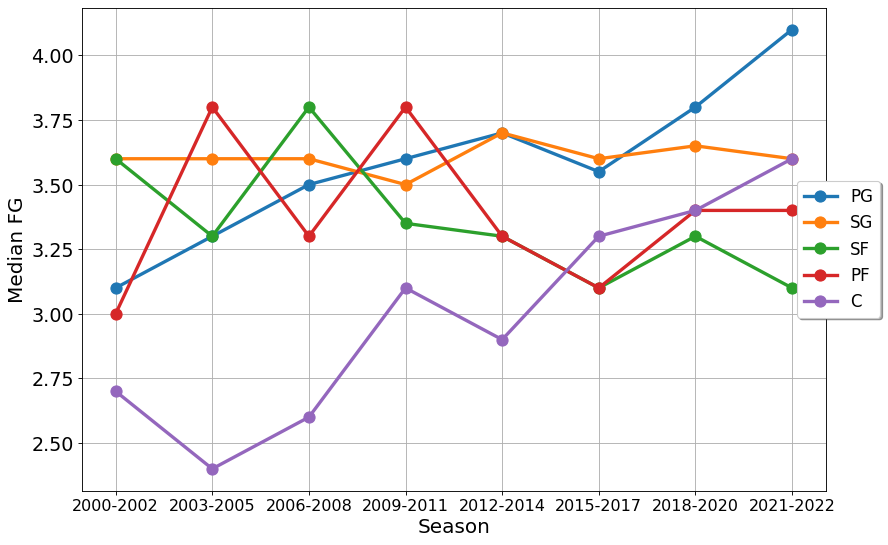

...

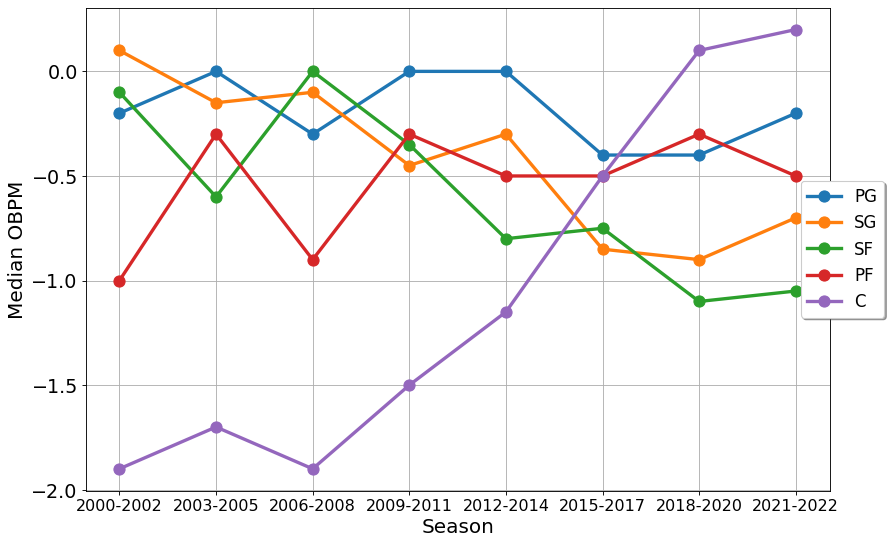

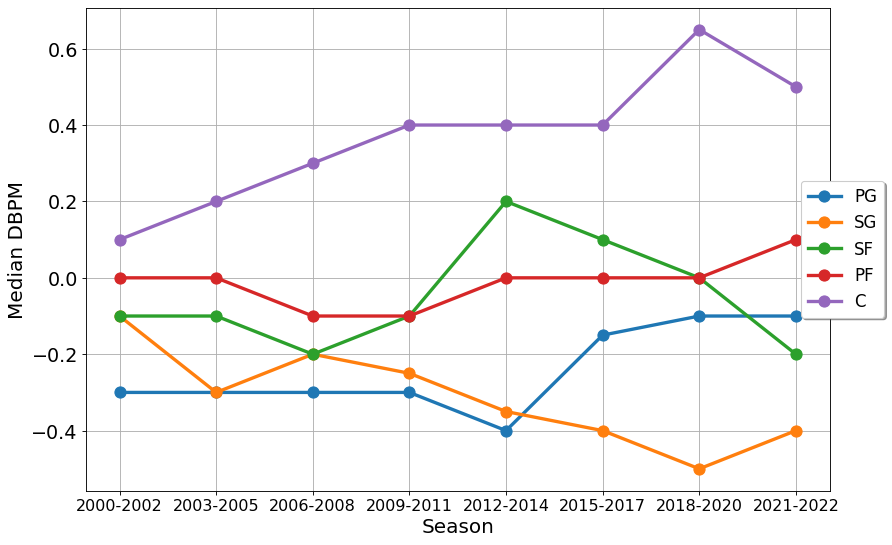

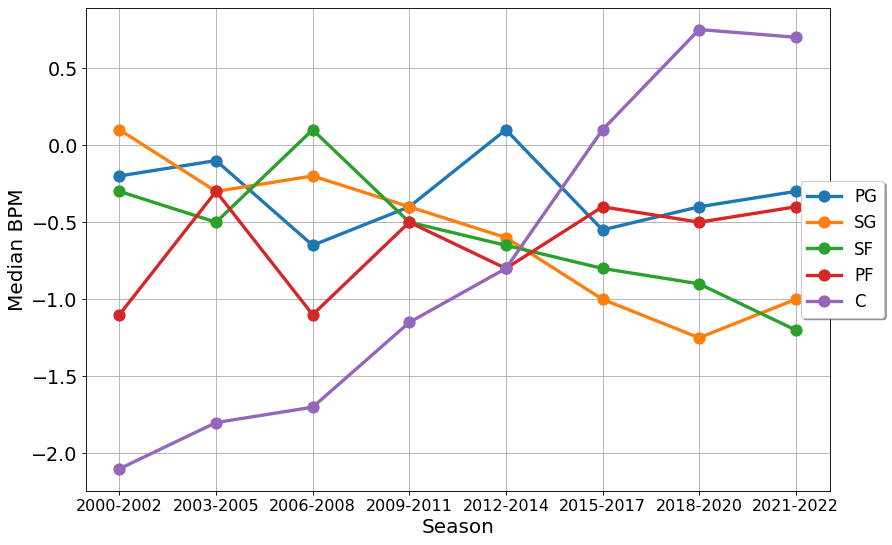

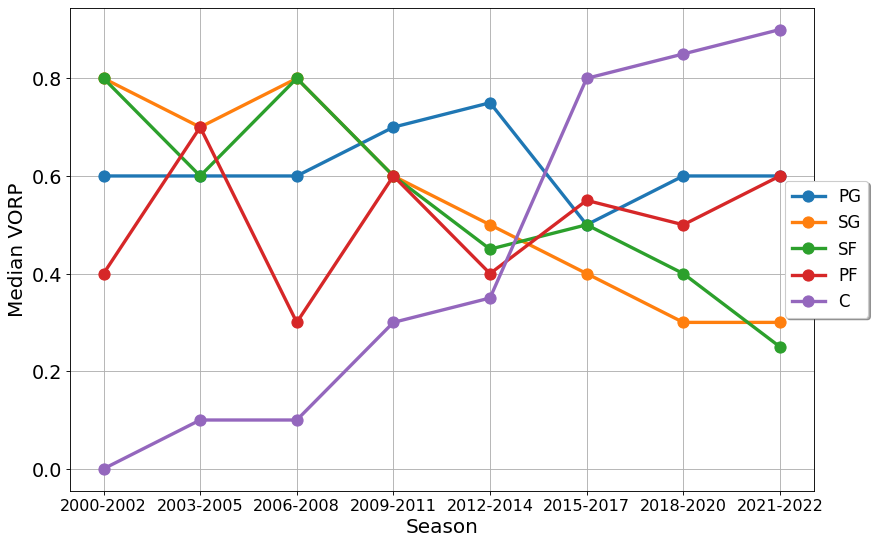

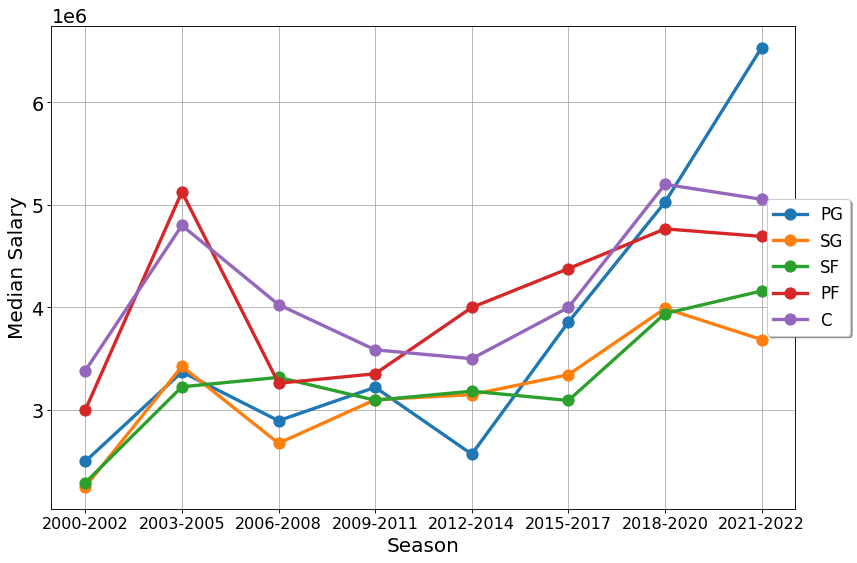

In [60]:
stats = median_by_pos_compact[0].columns
for stat in stats:
    median_by_pos_grouped_season = get_stat_by_position_each_season(stat, median_by_pos_compact)
    plot_position_graph_grouped_seasons(median_by_pos_grouped_season, stat, "Median", SEASONS)

# Analyzing highest scorers by position in the playoffs

In [61]:
#get average points for each position's leading scorer for every team
df = pd.DataFrame(playoff_player_dfs[18].groupby(by=['Tm','Pos'])['PTS'].max())
df.sort_values(by=['Tm', 'PTS'], ascending=[True, False], inplace=True)

In [62]:
#Find the average points and the position of each team's leading scorer in each season

highest_scorer_by_pos_and_season = {}
for team in TEAMS:
    highest_scorer_by_pos_and_season[team] = {}
    
for i in range(len(SEASONS)):
    df = pd.DataFrame(playoff_player_dfs[i])
    df.sort_values(by=['Tm', 'PTS'], ascending=[True, False], inplace=True)
    for team in TEAMS:
        players_from_team = df[df['Tm'] == team]
        if not players_from_team.empty:
            highest_scorer_from_team = players_from_team.iloc[0][['Pos', 'PTS']]
            highest_scorer_by_pos_and_season[team][SEASONS[i]] = list(highest_scorer_from_team)

In [63]:
#Find how many teams had a leading scorer of each position each season

position_with_more_scoring = {}

for position in POSITIONS:
    position_with_more_scoring[position] = np.zeros(len(SEASONS), dtype=int)
    
for i in range(len(SEASONS)):
    season = SEASONS[i]
    for team in TEAMS:
        if season in highest_scorer_by_pos_and_season[team]:
            position = highest_scorer_by_pos_and_season[team][season][0]
            if position in POSITIONS:        
                position_with_more_scoring[position][i] += 1

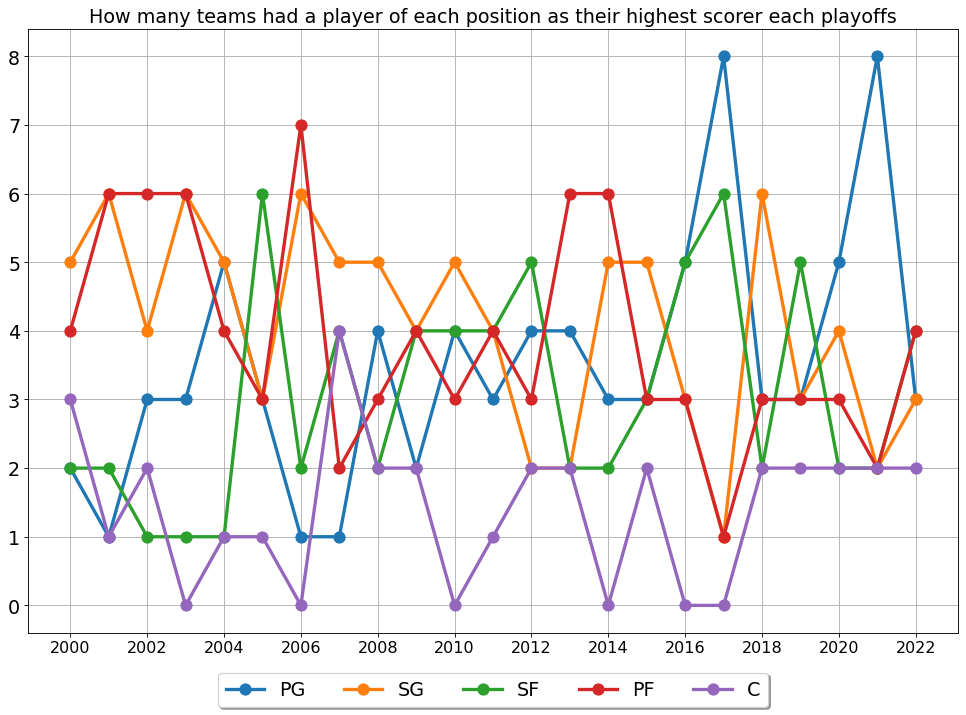

In [64]:
plt.figure(figsize=(15, 10), dpi=80)
plt.grid()
for position in POSITIONS:
    plt.plot(SEASONS, position_with_more_scoring[position], label=position, lw=3, marker='o', ms=10)
    
    
plt.title("How many teams had a player of each position as their highest scorer each playoffs")
plt.xticks(SEASONS[::2])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05),
          fancybox=True, shadow=True, ncol=5)
plt.savefig("Results/PositionsEvolution_Playoffs/Positions_with_most_scoring_in_the_playoffs.png")
plt.show()

# Analyzing the impact of positions by average stats in the Playoffs

In [65]:
#Get average stats for each position in every season
avg_by_pos = []

for i in range(len(SEASONS[:])):
    first_year, second_year = format_season(SEASONS[i])
    df = playoff_player_dfs[i].sort_values(by=['G'], ascending=False)
    df = df[df["Tm"] != "TOT"]
    df = df[df["MP"] >= 5]
    df = df.drop_duplicates(subset ="Player",keep = "first")
    df = pd.DataFrame(df.groupby(by=['Pos']).mean())
    df.sort_values(by='PTS', ascending=False, inplace=True)
    avg_by_pos.append(df)
    #df.to_csv("DataCollection/Positions_Playoffs/AverageStatsByPositon_Playoffs_{0}-{1}.csv".format(first_year, second_year))
    
    

ValueError: x and y must have same first dimension, but have shapes (1,) and (23,)

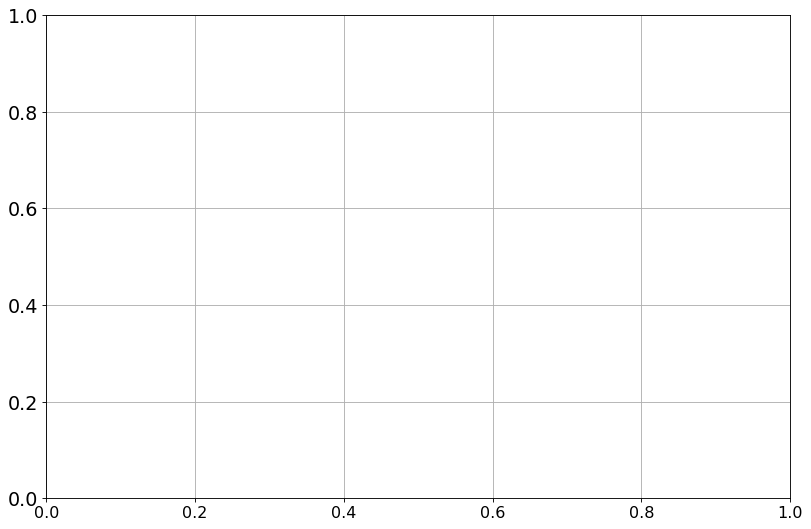

In [66]:
stats = avg_by_pos[0].columns
for stat in stats:
    avg_by_pos_each_season = get_stat_by_position_each_season(stat, avg_by_pos)
    plot_position_graph(avg_by_pos_each_season, stat, "Average", True)

In [ ]:
#Get standard deviation of stats for each position in every season

sd_by_pos = []

for i in range(len(SEASONS[:])):
    first_year, second_year = format_season(SEASONS[i])
    df = playoff_player_dfs[i].sort_values(by=['G'], ascending=False)
    df = df[df["Tm"] != "TOT"]
    df = df[df["MP"] >= 5]
    df = df.drop_duplicates(subset ="Player",keep = "first")
    df = pd.DataFrame(df.groupby(by=['Pos']).std())
    df.sort_values(by='PTS', ascending=False, inplace=True)
    sd_by_pos.append(df)
    #df.to_csv("DataCollection/Positions_Playoffs/StandardDeviationStatsByPositon_Playoffs_{0}-{1}.csv".format(first_year, second_year))
    
    

In [ ]:
stats = avg_by_pos[0].columns
for stat in stats:
    sd_by_pos_each_season = get_stat_by_position_each_season(stat, sd_by_pos)
    plot_position_graph(sd_by_pos_each_season, stat, "Standard Deviation", True)

In [ ]:
#Get standard deviation of stats for each position in every season

median_by_pos = []

for i in range(len(SEASONS[:])):
    first_year, second_year = format_season(SEASONS[i])
    df = playoff_player_dfs[i].sort_values(by=['G'], ascending=False)
    df = df[df["Tm"] != "TOT"]
    df = df[df["MP"] >= 5]
    df = df.drop_duplicates(subset ="Player",keep = "first")
    df = pd.DataFrame(df.groupby(by=['Pos']).median())
    df.sort_values(by='PTS', ascending=False, inplace=True)
    median_by_pos.append(df)
    #df.to_csv("DataCollection/Positions_Playoffs/MedianStatsByPositon_Playoffs_{0}-{1}.csv".format(first_year, second_year))
    
    

In [ ]:
stats = median_by_pos[0].columns
for stat in stats:
    median_by_pos_each_season = get_stat_by_position_each_season(stat, median_by_pos)
    plot_position_graph(median_by_pos_each_season, stat, "Median", True)

# Filtered by minutes

In [ ]:
df = player_dfs[-1].sort_values(by=['MP'], ascending=False)
max_g = df.max()['G']
df = df[df['G'] >= max_g / 2]
filtered_df  = pd.DataFrame(columns=df.columns)
for team in TEAMS:
    for position in POSITIONS:        
        filtered_df = filtered_df.append(df[(df["Tm"] == team) & (df["Pos"] == position)][:2])

filtered_df

In [ ]:
df = player_dfs[-1].sort_values(by=['G', 'MP'], ascending=False)
filtered_df  = pd.DataFrame(columns=df.columns)
for team in TEAMS:
    for position in POSITIONS:        
        filtered_df = filtered_df.append(df[(df["Tm"] == team) & (df["Pos"] == position)][:3])

filtered_df